In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import tensorflow as tf

from sklearn.pipeline import Pipeline
from pandas_profiling import ProfileReport
from sklearn.preprocessing import MinMaxScaler, StandardScaler, FunctionTransformer
from sklearn.model_selection import train_test_split, GridSearchCV, KFold, cross_validate
from sklearn.linear_model import LinearRegression, LogisticRegression, Ridge, Lasso
from sklearn.dummy import DummyRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.svm import SVR
from sklearn.neural_network import MLPRegressor
from sklearn import metrics
from sklearn.metrics import mean_poisson_deviance, mean_gamma_deviance, mean_squared_log_error, \
                            explained_variance_score, mean_absolute_error
from tensorflow import keras
from keras.engine.sequential import Sequential
from tensorflow.keras.layers import Dense, BatchNormalization, LeakyReLU, Activation, Dropout
from keras.callbacks import EarlyStopping, ModelCheckpoint


print(tf.__version__)

2.10.0


In [2]:
%matplotlib inline
sns.set_style('darkgrid')
RANDOM_STATE = 42

PATH_TPL = (r'C:\Users\EV\X_bp.xlsx', r'C:\Users\EV\X_nup.xlsx')

TARGET_VARS = ['Модуль упругости при растяжении, ГПа', 'Прочность при растяжении, МПа']
TARGET_FOR_NS = 'Соотношение матрица-наполнитель'

YES = 'Yy1Дд'

In [3]:


def data_parser(path_list, joint_type='inner'):
    data = pd.DataFrame()
    for i, path in enumerate(path_list):
        df_part = pd.read_excel(path_list[i], index_col=0)
        print(f'Исходные данные ({i + 1} часть) взяты из {path}, '
              f'размерность {i + 1} части данных =', df_part.shape)
        data = data.join(df_part, how=(joint_type if i > 0 else 'outer'))
    print(f'Данные объединены по индексу, тип объединения {joint_type}, размерность объединенного датасета = {data.shape}')
    
    # Перестановка столцов (целевые - в конец)
    columns_ending_with_targets = list(data.columns)
    for col in TARGET_VARS:      # target_vars = ('Модуль упругости при растяжении, ГПа', 'Прочность при растяжении, МПа')
        columns_ending_with_targets.remove(col)
        columns_ending_with_targets.append(col)
    return data.reindex(columns=columns_ending_with_targets)


def short_hist_and_boxes (df, n_rows=4, n_cols=5):
    fig=plt.figure(figsize=(24, 14))
    for i, column in enumerate(df.columns):
        if i < 12:
            ax=fig.add_subplot(n_rows, n_cols, i + 1)
        else:
            ax=fig.add_subplot(n_rows, n_cols, 16)
        sns.histplot(data=df, x=column, kde=True, bins=35)
    ax=fig.add_subplot(n_rows // 2, n_cols // 2, n_rows // 2 * (n_cols // 2))
    sns.boxplot(data = df, orient="h")
    fig.tight_layout()
    plt.show()


def plt_kde(dfr):
    print('Оценка плотности ядра')
    fig, ax = plt.subplots(figsize=(14, 4))
    dfr.plot(kind='kde', ax=ax)


def distribution_hist_and_boxes(data):
    # гистограммы распределения переменных, "ящики с усами"
    print('Гистограммы распределения переменных,\t\t "ящики с усами",\t\t гистограммы с узкими барами,')
    print(f"\t\t\t\t\t\t\t\t\t\t '1' - из первых 23 наблюдений")
    data["source"] = data['Плотность, кг/м3'] * 1000 % 1000 == 0
    fig, axes = plt.subplots(data.shape[1] - 1, 3, figsize=(18, 48))
    for i, col in enumerate(list(data.columns)[:-1]):    
        sns.histplot(data=data, x=col, kde=True, ax=axes[i, 0])
        sns.boxplot(data=data, x=col, ax=axes[i, 1])
        bar_width = (max(data[col]) - min(data[col]))/100
        sns.histplot(data=data, x=col, kde=False, ax=axes[i, 2],
                     binwidth=bar_width, hue='source')
    del data["source"]
    plt_kde(data)
    plt.show()
    

def pairplot_by_source(data):
    df_copy = data.copy()
    df_copy["source"] = df_copy["Угол нашивки, град"] - 180 * (df_copy['Плотность, кг/м3'] * 1000 % 1000 == 0)
    df_copy["source"][24:25] = 1                             # костыль для смещения цветовой схемы
    display(sns.pairplot(df_copy.drop("Угол нашивки, град", axis=1), hue = 'source', markers=["s", "D", ".", ".", "."], 
                 diag_kind= 'auto', plot_kws = {'alpha': 0.3, 's': 25}, palette='Set1', height=2))
    
    

In [4]:
       
        
def visual_outliers_seacher(data):

    # сохраняем в словарь число выбросов, выявленных разными методами
    outliers_counter = {'Метод 3-х сигм': 0,
                        'Метод 2-х сигм': 0,
                        'Метод межквартильных расстояний:': 0
                       }
    print()
    for col in data:
        is_out = pd.DataFrame()
        is_out['z_abs'] = ((data[col] - data[col].mean()) / data[col].std()).abs()
        is_out['3_sygma'] = (is_out['z_abs'] > 3)
        outliers_3_sygma = is_out['3_sygma'].sum()
        outliers_counter['Метод 3-х сигм'] += outliers_3_sygma

        is_out['2_sygma'] = (is_out['z_abs'] > 2)
        outliers_2_sygma = is_out['2_sygma'].sum()
        outliers_counter['Метод 2-х сигм'] += outliers_2_sygma

        inter_quantile = np.quantile(data[col], 0.75) - np.quantile(data[col], 0.25)
        lower_column = np.quantile(data[col], 0.25) - inter_quantile * 1.5
        upper_column = np.quantile(data[col], 0.75) + 1.5 * inter_quantile
        is_out['inter_qu'] = data[col].between(lower_column, upper_column, inclusive='both').map({True: False, False: True})
        outliers_inter_quantile = is_out['inter_qu'].sum()
        outliers_counter['Метод межквартильных расстояний:'] += outliers_inter_quantile

        is_out['encoder'] = is_out['3_sygma'] + 2 * is_out['2_sygma'] + 4 * is_out['inter_qu']
        print(f'{col}: за три сигмы {outliers_3_sygma}, за две сигмы {outliers_2_sygma}'
              f', за полтора межкв.интервала {outliers_inter_quantile}')
        fig, axes = plt.subplots(1, 2, figsize=(16, 3))
        sns.histplot(data=is_out, x=data[col], hue='encoder', multiple='stack', legend=False, ax=axes[0],
                 palette='Set2')
        sns.boxplot(data=data[col], x=data[col], ax=axes[1])
        for i in range(8):
            outliers = pd.DataFrame(data[is_out['encoder']==i])
            if outliers.shape[0]:
                sns.stripplot(data=outliers, x=outliers[col], color='cwywwwbr'[i], ax=axes[1])
        plt.show()    
    print('Число значений-выбросов среди всех параметров:')
    for key, val in outliers_counter.items():
        print(f'{key} - {val}')
    data = data.drop(['3_sygma', '2_sygma', 'inter_qu', 'encoder'], axis=1, errors='ignore')


def data_cleaner(data):
    # очистка от выбросов методом 3 сигм
    is_outlier = np.zeros((df.shape[0],)).astype('bool')
    for col in data:
        is_outlier += ((data[col] - data[col].mean()) / data[col].std()).abs() > 3
    data = data.iloc[list(np.invert(is_outlier))]
    print(f'Проведена очистка данных методом 3-x сигм, размерность очищенного датасета = {data.shape})')
    return data
    

data_cleaner_estimator = FunctionTransformer(data_cleaner)

In [25]:
def short_outliers_seacher(data):
    # Оцениваю выбросы методами 3-х сигм, 2-х сигм и межквартильных расстояний
    
    # сохраняем сюда число выбросов, выявленных разными методами
    outliers_counter = {'Метод 3-х сигм': 0,
                        'Метод 2-х сигм': 0,
                        'Метод межквартильных расстояний:': 0
                       }
    for col in data:
        z_score_column = (data[col] - data[col].mean()) / data[col].std()
        outliers_counter['Метод 3-х сигм'] += (z_score_column.abs() > 3).sum()
        outliers_counter['Метод 2-х сигм'] += (z_score_column.abs() > 2).sum()
        inter_quantile_column = np.quantile(data[col], 0.75) - np.quantile(data[col], 0.25)
        lower_column = np.quantile(data[col], 0.25) - 1.5 * inter_quantile_column
        upper_column = np.quantile(data[col], 0.25) + 1.5 * inter_quantile_column
        outliers_counter['Метод межквартильных расстояний:'] += (data[col] <= lower_column).sum()
        outliers_counter['Метод межквартильных расстояний:'] += (data[col] >= upper_column).sum()
    print('\n\tСколько значений-выбросов среди всех параметров выявлено:')
    for key, val in outliers_counter.items():
        print(f'{key} - {val}')


def correlation_matrix(data):
    corr = data.corr()
    fig, ax = plt.subplots(figsize=(12, 8))
    sns.heatmap(corr, vmin=-.15, vmax=.15, center= 0, annot=True, fmt='.2f', cmap='coolwarm', ax=ax)
    plt.show()
    

In [6]:


def mean_median_outputer(data):
    description = data.describe().T
    description.rename(columns = {'50%':'median'}, inplace = True)
    print('Среднее и медианное значение для каждой колонки:')
    display(description.style.format(precision=2))
    

def dublicate_seacher(data):
    print('\tСтроки, в которых обнаружены повторы значений отдельных переменных (кроме "Угол нашивки, град")')
    for col in data.columns[data.columns != 'Угол нашивки, град']:
        print(f'"{col}" повторы в сторках:', 
              str(list(data[data.duplicated([col])].T.columns)).strip('[').strip(']'))
        

def EDA_search_dialog(dfr):
    try:
        if input('Сделать ProfileReport - разведочный анализ данных, Wall time: 26.4 s  (Yes=1 / No= any_key)? ')[0] in YES:
            display(ProfileReport(dfr))                  # Разведочный анализ данных
        try:
            if input('Показать подробные гистограммы и "ящики с усами", Wall time: 5.99 s   (Yes=1 / No= any_key)? ')[0] in YES:
                distribution_hist_and_boxes(dfr)             # гистограммы распределения и диаграммы ящика с усами, KDE
            else:
                print('Тогда в кратце: гистограммы и "ящики с усами", Wall time: 1.38 s:')
                short_hist_and_boxes(dfr)
        except IndexError: pass
        try:
            choise = int(input('''Попарные графики рассеяния точек сделаны в трёх вариантах:  стандартный, Wall time: 12.1 s
                       более удобный для анализа c hue="Угол нашивки, град", Wall time: 25.4 s
                                         и для вылавливания первых 23 строк, Wall time: 26.9 s
    Сколько вариантов попарных графиков рассеяния построить (1, 2, 3 или 0)? '''))
        except ValueError:
            choise = -1
        if choise > 0:
            sns.pairplot(dfr, height=2)                  # попарные графики рассеяния точек
        if choise > 1:
            sns.pairplot(dfr, hue = 'Угол нашивки, град', diag_kind= 'auto', 
                         plot_kws = {'alpha': 0.1, 's': 25}, palette='Set1', height=1.5)
        if choise == 3:
            pairplot_by_source(dfr)
        if choise == 0:
            print('Тогда хотя бы корреляционную матрицу построю,  Wall time: 576 ms:')
            correlation_matrix(dfr)
        mean_median_outputer(dfr)
        print(f'\tУникальные значения переменных\n{dfr.nunique()}')
        dublicate_seacher(dfr)
        try:
            if input('Делать визуализацию при анализе выбросов, Wall time: 3.89 s  (Yes=1 / No= any_key)? ')[0] in YES:
                visual_outliers_seacher(dfr)
            else:
                short_outliers_seacher(dfr)                  # анализ выбросов
        except IndexError: pass
                                                        # проверка наличия пропусков
        print(f'\n\tПроверка наличия пропусков\n{dfr.isnull().sum()}')
    except IndexError: pass
    
    

In [7]:


def normaliser(dataframe, scaler=MinMaxScaler()):
    dataframe = pd.DataFrame(scaler.fit_transform(dataframe), 
                             columns = dataframe.columns, 
                             index=dataframe.index)
    print('\tПроведена нормализация данных:')
    dataframe = dataframe.astype({'Угол нашивки, град': 'int32'})
    display(dataframe.describe().T.style.format(precision=2))
    display(dataframe.nunique())
    display(dataframe.info())
    try:
        if input('Построить корреляционную мартицу, Wall time: 576 ms  (Yes=1 / No= any_key)? ')[0] in YES:
            correlation_matrix(dataframe)
    except IndexError: pass
    try:
        if input('Оценить нормализацию по гистограммам и "ящикам с усами", Wall time: 1.99 s  '
                 '(Yes=1 / No= any_key)? ')[0] in YES:
            short_hist_and_boxes(dataframe)
    except IndexError: pass
    return dataframe
    
    

In [8]:


def cv_run(models, x, y):                                 # используется scoring_dict, RANDOM_STATE
    cross_val = KFold(10, shuffle=True, random_state=RANDOM_STATE)
    mistakes = pd.DataFrame()
    for model_name, model in models.items():
        scores = cross_validate(model, x, y, cv=cross_val, scoring=list(scoring_dict.values()))
        for key, val in scoring_dict.items():
            mistakes.loc[model_name, key] = scores[f'test_{val}'].mean()
    display(mistakes.style.format(precision=2).highlight_max(axis=0))


def grid_search(model, params, x, y, key_scorer='MAE'):    # используется scoring_dict, RANDOM_STATE
    stat = pd.DataFrame()
    cv = KFold(10, shuffle=True, random_state=RANDOM_STATE)
    scoring = scoring_dict[key_scorer]
    searcher = GridSearchCV(model, params, cv=cv, scoring=scoring, refit=key_scorer,
                           n_jobs=-1, return_train_score=True, verbose=3)
    searcher.fit(x, y)
    stat.loc[:, y.name] = searcher.cv_results_['params']
    stat.loc[:, key_scorer] = searcher.cv_results_['mean_test_score']
    stat.loc[:, 'rank'] = searcher.cv_results_['rank_test_score']
    return stat, searcher.best_estimator_


def get_metrics(model_name, y, y_pred):
    stat = pd.DataFrame()
    stat.loc[model_name, 'R2'] = metrics.r2_score(y, y_pred)
    stat.loc[model_name, 'RMSE'] = metrics.mean_squared_error(y, y_pred, squared=False) * -1
    stat.loc[model_name, 'MAE'] = metrics.mean_absolute_error(y, y_pred) * -1
    stat.loc[model_name, 'MAPE'] = metrics.mean_absolute_percentage_error(y, y_pred) * -1
    stat.loc[model_name, 'max_error'] = metrics.max_error(y, y_pred) * -1
    return stat



Исходные данные (1 часть) взяты из C:\Users\EV\X_bp.xlsx, размерность 1 части данных = (1023, 10)
Исходные данные (2 часть) взяты из C:\Users\EV\X_nup.xlsx, размерность 2 части данных = (1040, 3)
Данные объединены по индексу, тип объединения inner, размерность объединенного датасета = (1023, 13)
Сделать ProfileReport - разведочный анализ данных, Wall time: 26.4 s  (Yes=1 / No= any_key)? 1


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Показать подробные гистограммы и "ящики с усами", Wall time: 5.99 s   (Yes=1 / No= any_key)? 1
Гистограммы распределения переменных,		 "ящики с усами",		 гистограммы с узкими барами,
										 '1' - из первых 23 наблюдений
Оценка плотности ядра


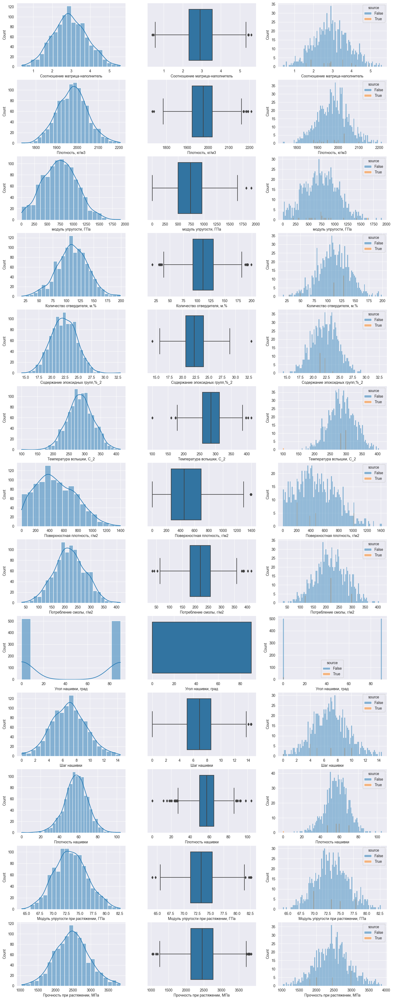

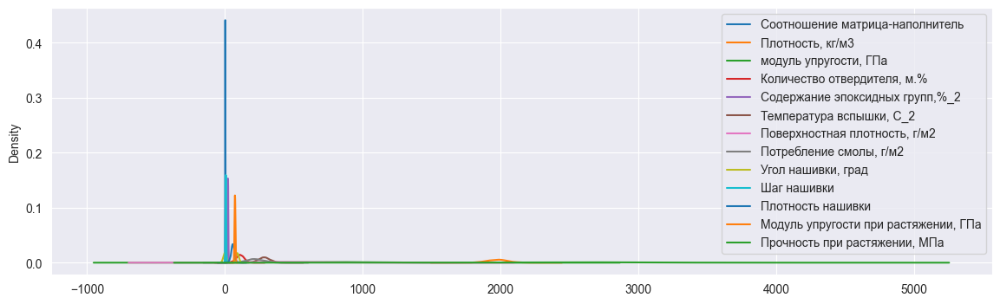

Попарные графики рассеяния точек сделаны в трёх вариантах:  стандартный, Wall time: 12.1 s
                       более удобный для анализа c hue="Угол нашивки, град", Wall time: 25.4 s
                                         и для вылавливания первых 23 строк, Wall time: 26.9 s
    Сколько вариантов попарных графиков рассеяния построить (1, 2, 3 или 0)? 3


C:\Users\EV\AppData\Local\Temp\ipykernel_14896\1417794809.py:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_copy["source"][24:25] = 1                             # костыль для смещения цветовой схемы


Среднее и медианное значение для каждой колонки:


,count,mean,std,min,25%,median,75%,max
Соотношение матрица-наполнитель,1023.00,2.93,0.91,0.39,2.32,2.91,3.55,5.59
"Плотность, кг/м3",1023.00,1975.73,73.73,1731.76,1924.16,1977.62,2021.37,2207.77
"модуль упругости, ГПа",1023.00,739.92,330.23,2.44,500.05,739.66,961.81,1911.54
"Количество отвердителя, м.%",1023.00,110.57,28.30,17.74,92.44,110.56,129.73,198.95
"Содержание эпоксидных групп,%_2",1023.00,22.24,2.41,14.25,20.61,22.23,23.96,33.00
"Температура вспышки, С_2",1023.00,285.88,40.94,100.00,259.07,285.90,313.00,413.27
"Поверхностная плотность, г/м2",1023.00,482.73,281.31,0.60,266.82,451.86,693.23,1399.54
"Потребление смолы, г/м2",1023.00,218.42,59.74,33.80,179.63,219.20,257.48,414.59
"Угол нашивки, град",1023.00,44.25,45.02,0.00,0.00,0.00,90.00,90.00
Шаг нашивки,1023.00,6.90,2.56,0.00,5.08,6.92,8.59,14.44


	Уникальные значения переменных
Соотношение матрица-наполнитель         1014
Плотность, кг/м3                        1013
модуль упругости, ГПа                   1020
Количество отвердителя, м.%             1005
Содержание эпоксидных групп,%_2         1004
Температура вспышки, С_2                1003
Поверхностная плотность, г/м2           1004
Потребление смолы, г/м2                 1003
Угол нашивки, град                         2
Шаг нашивки                              989
Плотность нашивки                        988
Модуль упругости при растяжении, ГПа    1004
Прочность при растяжении, МПа           1004
dtype: int64
	Строки, в которых обнаружены повторы значений отдельных переменных (кроме "Угол нашивки, град")
"Соотношение матрица-наполнитель" повторы в сторках: 1, 2, 3, 13, 16, 19, 20, 21, 22
"Плотность, кг/м3" повторы в сторках: 1, 2, 3, 4, 14, 15, 17, 19, 20, 22
"модуль упругости, ГПа" повторы в сторках: 1, 2, 3
"Количество отвердителя, м.%" повторы в сторках: 5, 6, 7, 8, 9, 

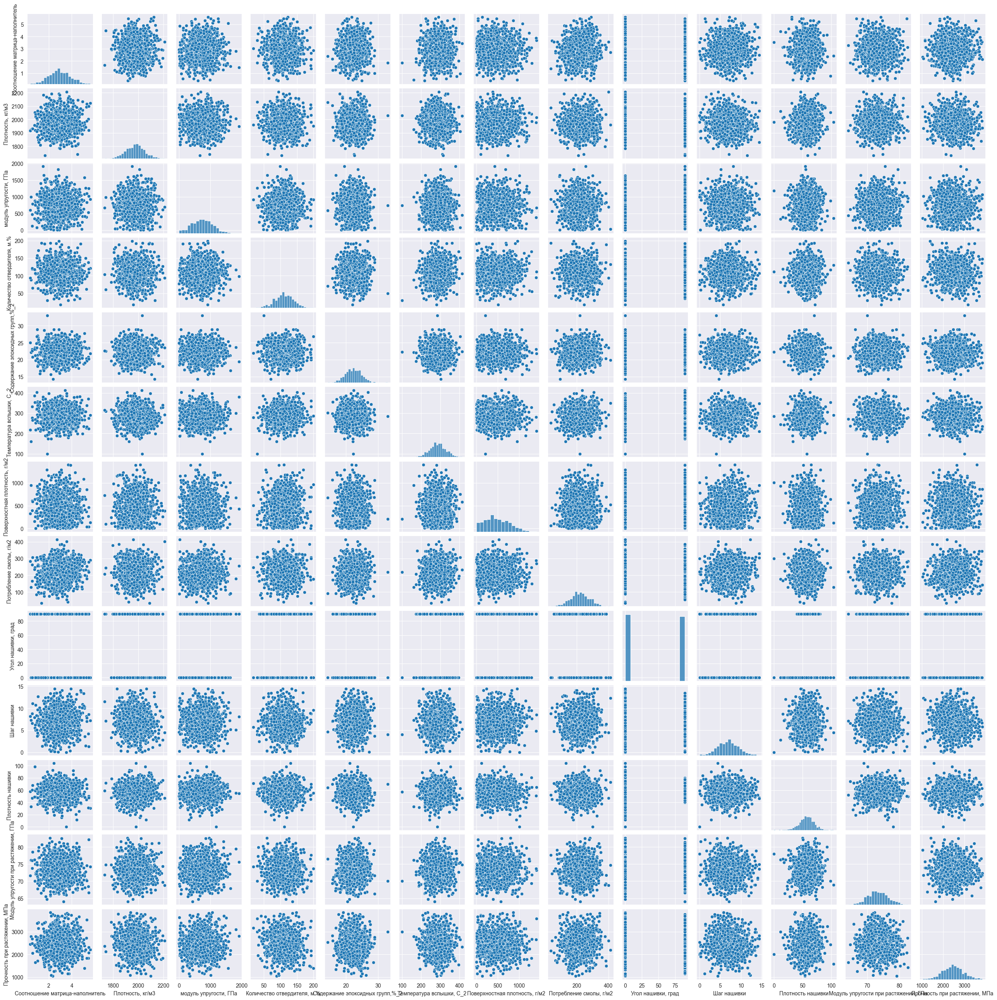

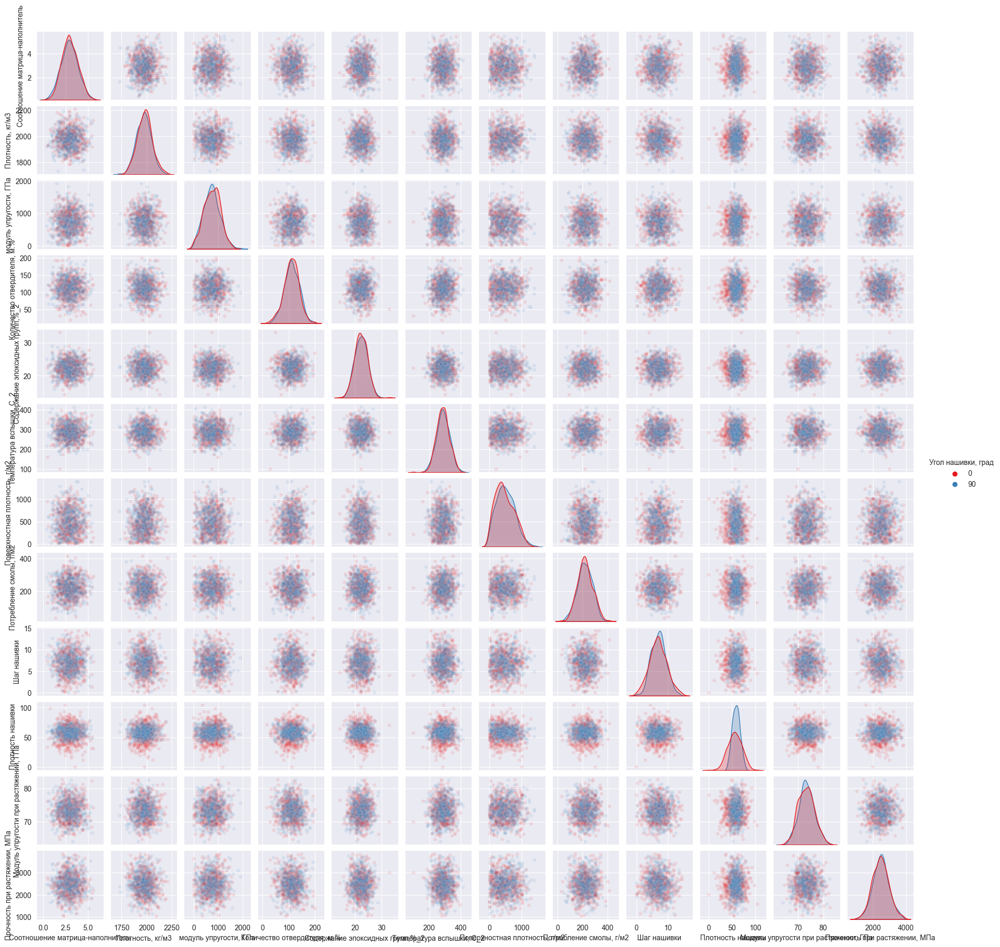

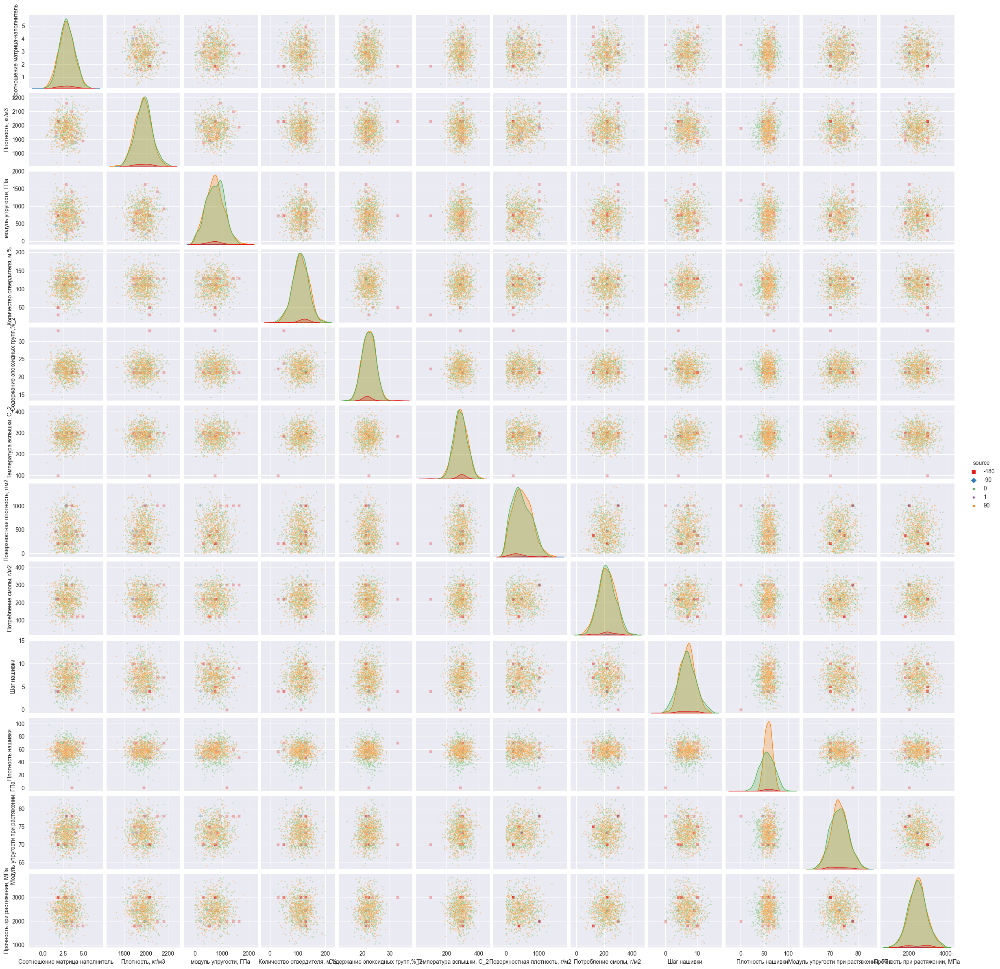

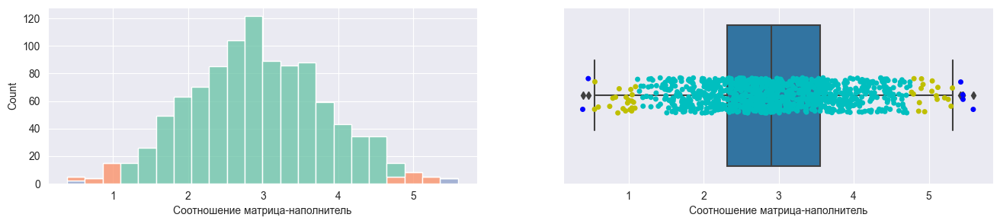

Плотность, кг/м3: за три сигмы 3, за две сигмы 50, за полтора межкв.интервала 9


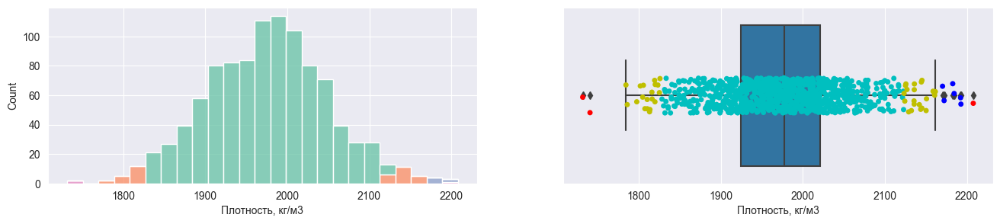

модуль упругости, ГПа: за три сигмы 2, за две сигмы 51, за полтора межкв.интервала 2


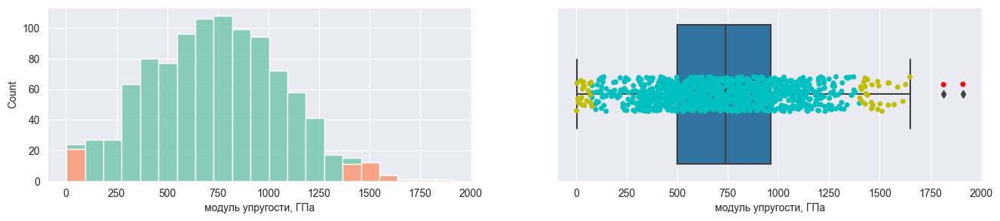

Количество отвердителя, м.%: за три сигмы 2, за две сигмы 54, за полтора межкв.интервала 14


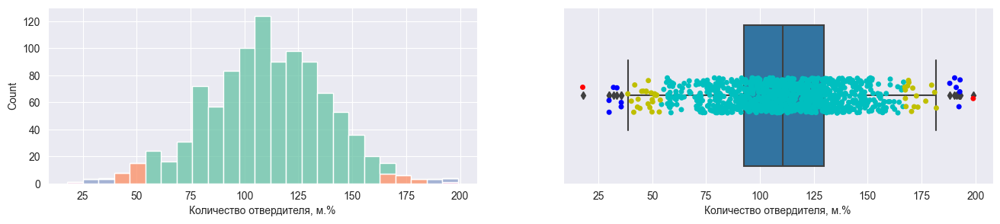

Содержание эпоксидных групп,%_2: за три сигмы 2, за две сигмы 43, за полтора межкв.интервала 2


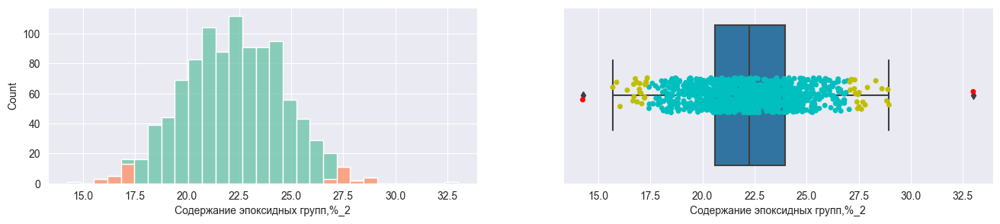

Температура вспышки, С_2: за три сигмы 3, за две сигмы 44, за полтора межкв.интервала 8


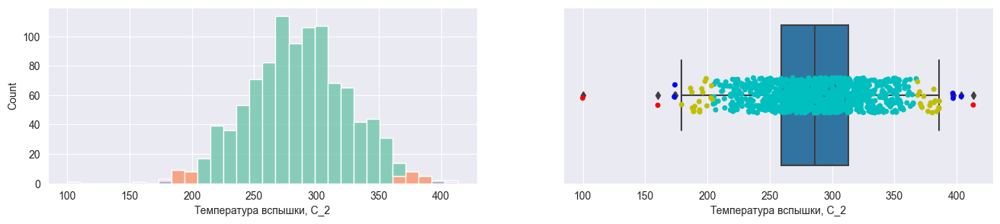

Поверхностная плотность, г/м2: за три сигмы 2, за две сигмы 28, за полтора межкв.интервала 2


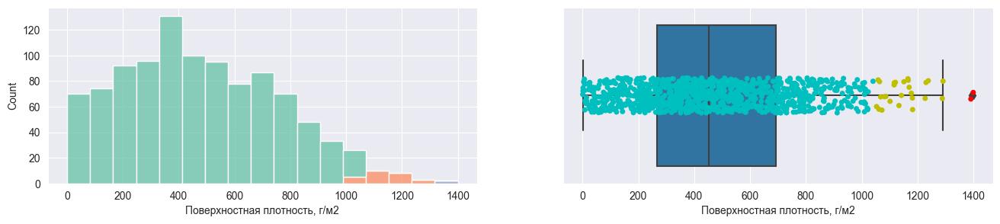

Потребление смолы, г/м2: за три сигмы 3, за две сигмы 45, за полтора межкв.интервала 8


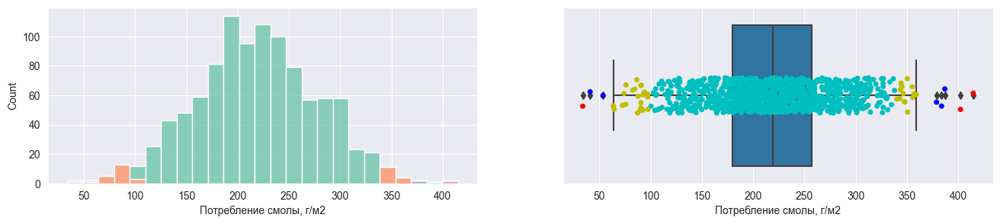

Угол нашивки, град: за три сигмы 0, за две сигмы 0, за полтора межкв.интервала 0


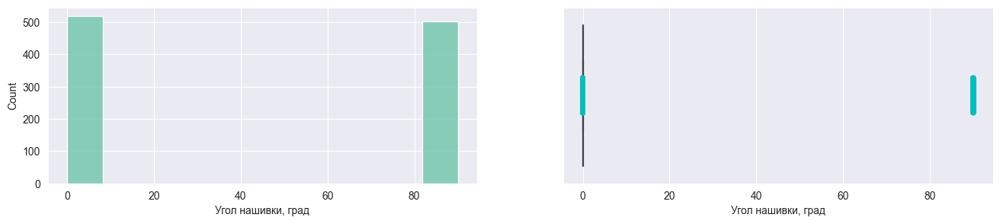

Шаг нашивки: за три сигмы 0, за две сигмы 55, за полтора межкв.интервала 4


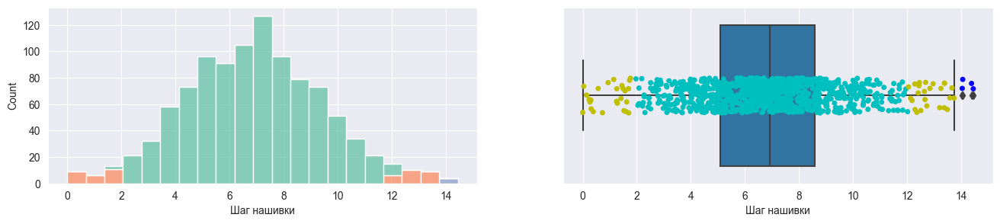

Плотность нашивки: за три сигмы 7, за две сигмы 52, за полтора межкв.интервала 21


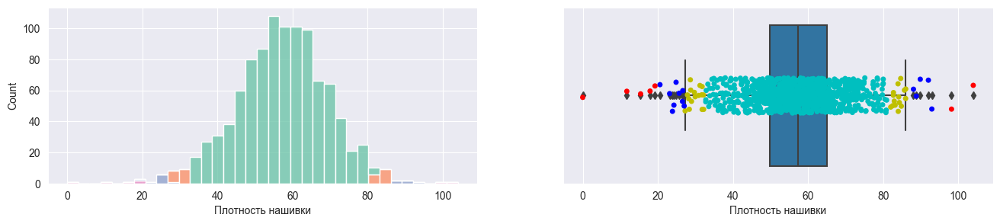

Модуль упругости при растяжении, ГПа: за три сигмы 0, за две сигмы 52, за полтора межкв.интервала 6


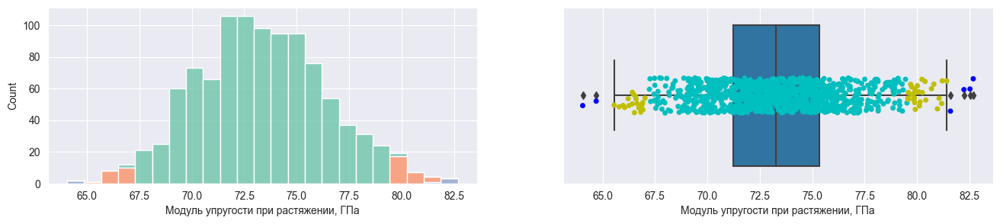

Прочность при растяжении, МПа: за три сигмы 0, за две сигмы 55, за полтора межкв.интервала 11


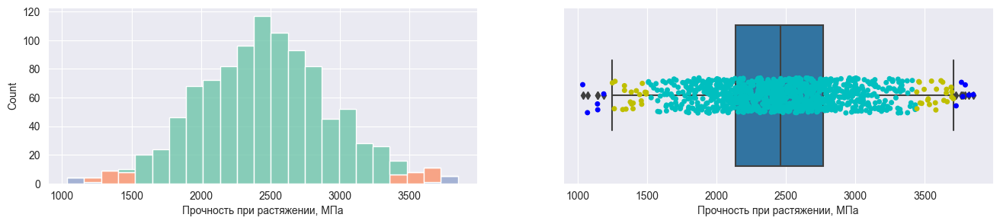

Число значений-выбросов среди всех параметров:
Метод 3-х сигм - 24
Метод 2-х сигм - 575
Метод межквартильных расстояний: - 93

	Проверка наличия пропусков
Соотношение матрица-наполнитель         0
Плотность, кг/м3                        0
модуль упругости, ГПа                   0
Количество отвердителя, м.%             0
Содержание эпоксидных групп,%_2         0
Температура вспышки, С_2                0
Поверхностная плотность, г/м2           0
Потребление смолы, г/м2                 0
Угол нашивки, град                      0
Шаг нашивки                             0
Плотность нашивки                       0
Модуль упругости при растяжении, ГПа    0
Прочность при растяжении, МПа           0
dtype: int64
Проведена очистка данных методом 3-x сигм, размерность очищенного датасета = (1000, 13))
Сделать ProfileReport - разведочный анализ данных, Wall time: 26.4 s  (Yes=1 / No= any_key)? 0
Показать подробные гистограммы и "ящики с усами", Wall time: 5.99 s   (Yes=1 / No= any_key)? 1
Гистогр

C:\Users\EV\AppData\Local\Temp\ipykernel_14896\1417794809.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data["source"] = data['Плотность, кг/м3'] * 1000 % 1000 == 0


Оценка плотности ядра


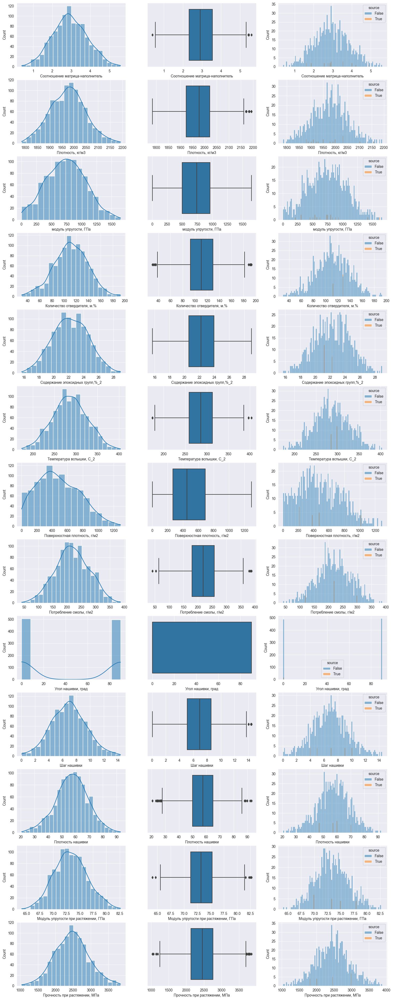

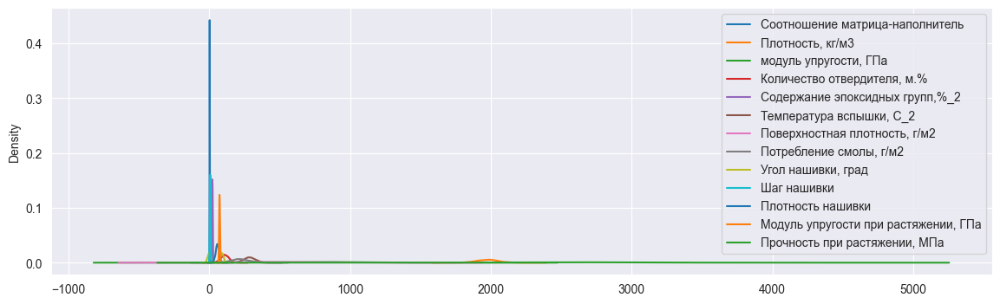

Попарные графики рассеяния точек сделаны в трёх вариантах:  стандартный, Wall time: 12.1 s
                       более удобный для анализа c hue="Угол нашивки, град", Wall time: 25.4 s
                                         и для вылавливания первых 23 строк, Wall time: 26.9 s
    Сколько вариантов попарных графиков рассеяния построить (1, 2, 3 или 0)? 0
Тогда хотя бы корреляционную матрицу построю,  Wall time: 576 ms:


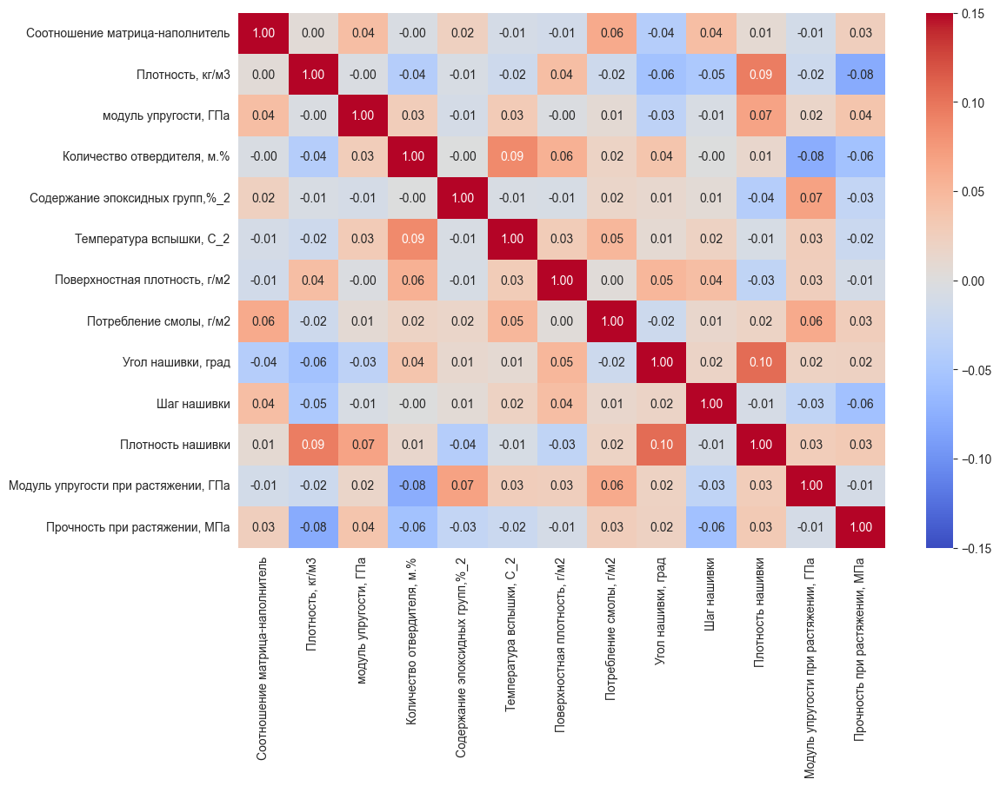

Среднее и медианное значение для каждой колонки:


,count,mean,std,min,25%,median,75%,max
Соотношение матрица-наполнитель,1000.00,2.94,0.91,0.39,2.32,2.91,3.55,5.59
"Плотность, кг/м3",1000.00,1975.40,72.95,1784.48,1923.63,1977.32,2021.16,2192.74
"модуль упругости, ГПа",1000.00,738.68,327.55,2.44,500.77,741.15,961.65,1649.42
"Количество отвердителя, м.%",1000.00,110.82,27.87,29.96,92.52,110.65,129.85,192.85
"Содержание эпоксидных групп,%_2",1000.00,22.24,2.38,15.70,20.58,22.22,23.97,28.96
"Температура вспышки, С_2",1000.00,285.96,40.23,173.48,259.10,285.85,313.03,403.65
"Поверхностная плотность, г/м2",1000.00,479.86,277.71,0.60,266.98,450.87,691.53,1291.34
"Потребление смолы, г/м2",1000.00,218.25,58.94,41.05,179.81,218.70,257.47,386.90
"Угол нашивки, град",1000.00,44.64,45.02,0.00,0.00,0.00,90.00,90.00
Шаг нашивки,1000.00,6.91,2.56,0.04,5.11,6.92,8.59,14.44


	Уникальные значения переменных
Соотношение матрица-наполнитель         994
Плотность, кг/м3                        993
модуль упругости, ГПа                   999
Количество отвердителя, м.%             983
Содержание эпоксидных групп,%_2         983
Температура вспышки, С_2                982
Поверхностная плотность, г/м2           984
Потребление смолы, г/м2                 983
Угол нашивки, град                        2
Шаг нашивки                             968
Плотность нашивки                       967
Модуль упругости при растяжении, ГПа    984
Прочность при растяжении, МПа           984
dtype: int64
	Строки, в которых обнаружены повторы значений отдельных переменных (кроме "Угол нашивки, град")
"Соотношение матрица-наполнитель" повторы в сторках: 3, 13, 16, 20, 21, 22
"Плотность, кг/м3" повторы в сторках: 3, 4, 14, 15, 17, 20, 22
"модуль упругости, ГПа" повторы в сторках: 3
"Количество отвердителя, м.%" повторы в сторках: 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20,

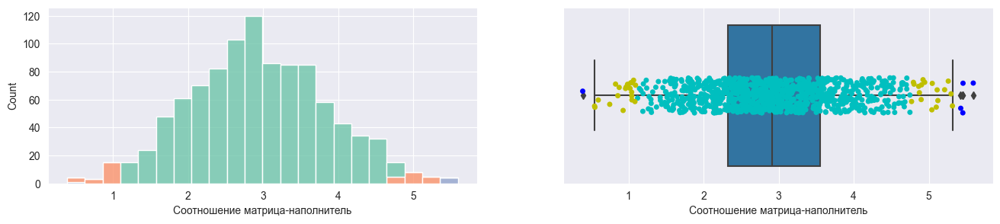

Плотность, кг/м3: за три сигмы 0, за две сигмы 50, за полтора межкв.интервала 6


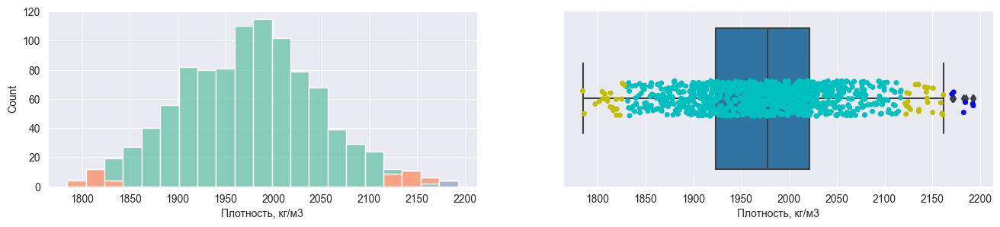

модуль упругости, ГПа: за три сигмы 0, за две сигмы 52, за полтора межкв.интервала 0


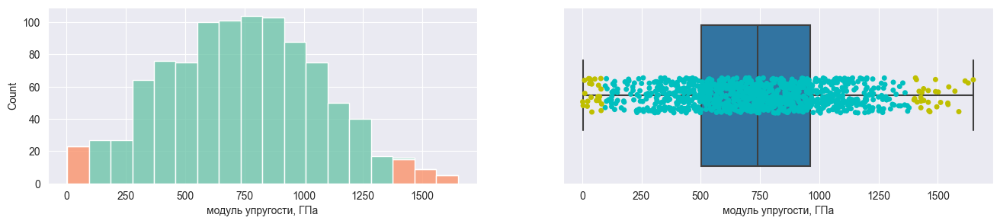

Количество отвердителя, м.%: за три сигмы 0, за две сигмы 52, за полтора межкв.интервала 10


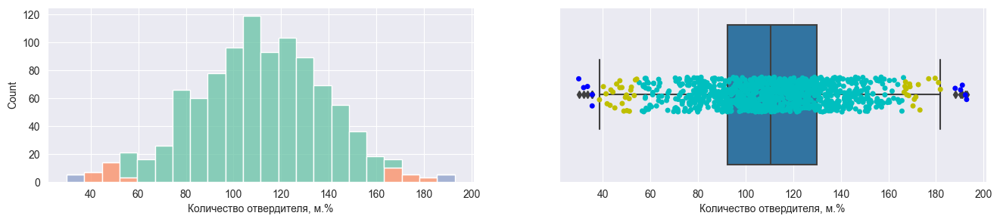

Содержание эпоксидных групп,%_2: за три сигмы 0, за две сигмы 45, за полтора межкв.интервала 0


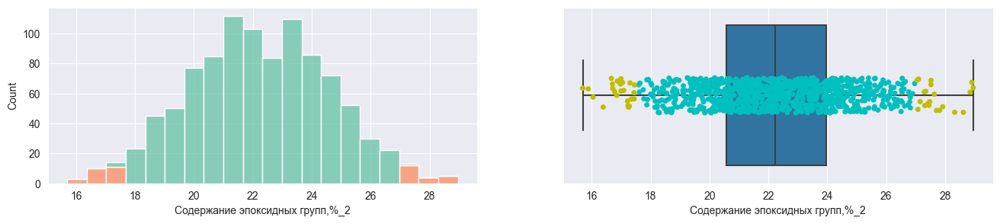

Температура вспышки, С_2: за три сигмы 0, за две сигмы 43, за полтора межкв.интервала 5


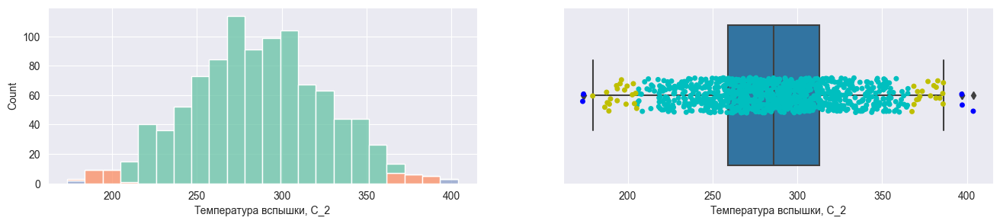

Поверхностная плотность, г/м2: за три сигмы 0, за две сигмы 27, за полтора межкв.интервала 0


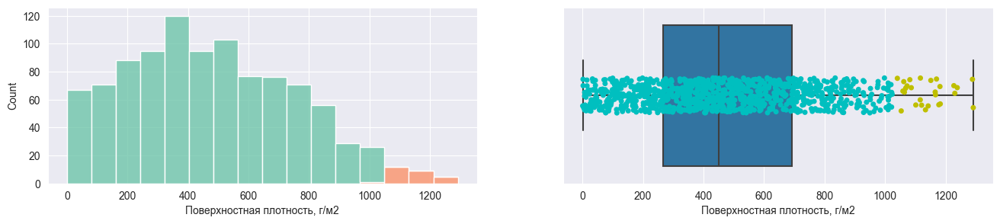

Потребление смолы, г/м2: за три сигмы 1, за две сигмы 43, за полтора межкв.интервала 5


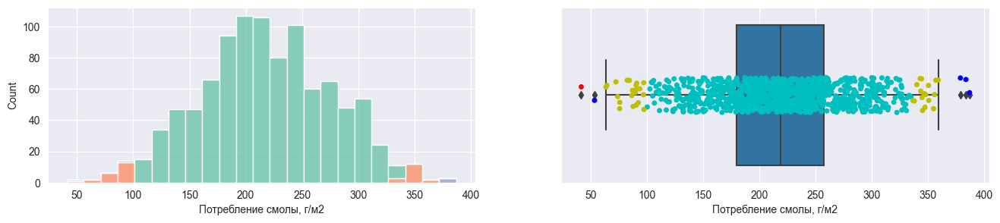

Угол нашивки, град: за три сигмы 0, за две сигмы 0, за полтора межкв.интервала 0


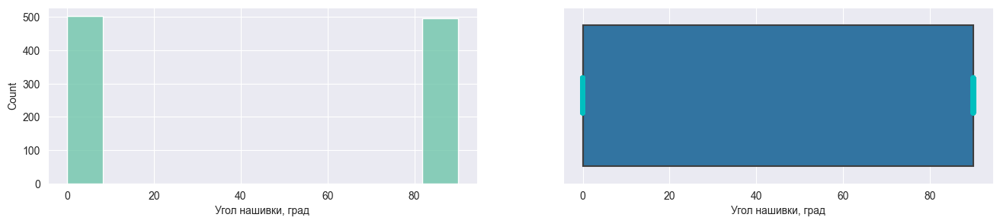

Шаг нашивки: за три сигмы 0, за две сигмы 53, за полтора межкв.интервала 4


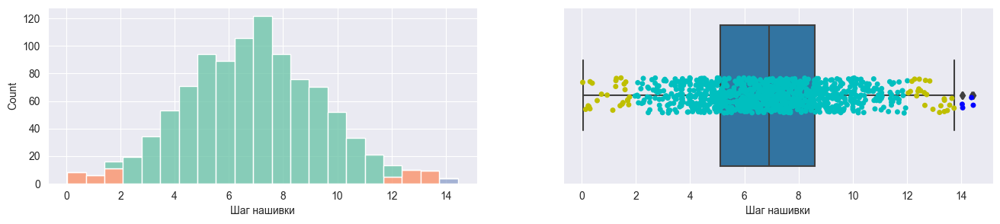

Плотность нашивки: за три сигмы 2, за две сигмы 49, за полтора межкв.интервала 15


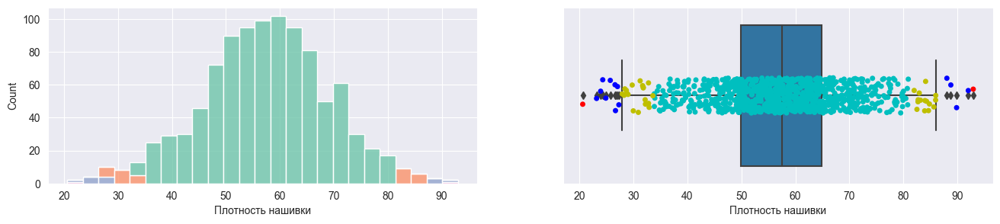

Модуль упругости при растяжении, ГПа: за три сигмы 1, за две сигмы 51, за полтора межкв.интервала 6


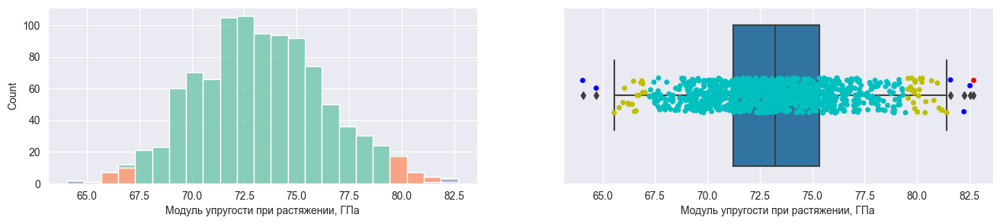

Прочность при растяжении, МПа: за три сигмы 0, за две сигмы 53, за полтора межкв.интервала 12


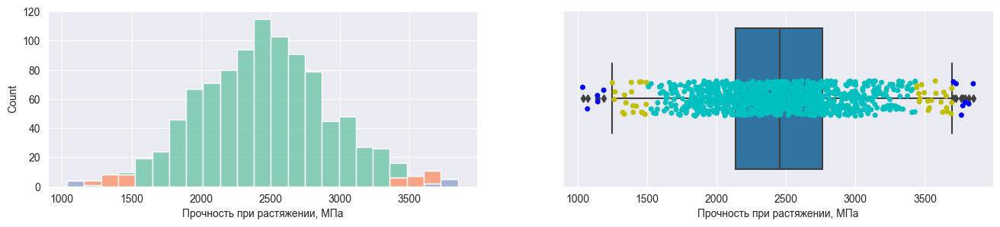

Число значений-выбросов среди всех параметров:
Метод 3-х сигм - 4
Метод 2-х сигм - 562
Метод межквартильных расстояний: - 68

	Проверка наличия пропусков
Соотношение матрица-наполнитель         0
Плотность, кг/м3                        0
модуль упругости, ГПа                   0
Количество отвердителя, м.%             0
Содержание эпоксидных групп,%_2         0
Температура вспышки, С_2                0
Поверхностная плотность, г/м2           0
Потребление смолы, г/м2                 0
Угол нашивки, град                      0
Шаг нашивки                             0
Плотность нашивки                       0
Модуль упругости при растяжении, ГПа    0
Прочность при растяжении, МПа           0
dtype: int64
	Проведена нормализация данных:


,count,mean,std,min,25%,50%,75%,max
Соотношение матрица-наполнитель,1000.00,0.49,0.17,0.00,0.37,0.48,0.61,1.00
"Плотность, кг/м3",1000.00,0.47,0.18,0.00,0.34,0.47,0.58,1.00
"модуль упругости, ГПа",1000.00,0.45,0.20,0.00,0.30,0.45,0.58,1.00
"Количество отвердителя, м.%",1000.00,0.50,0.17,0.00,0.38,0.50,0.61,1.00
"Содержание эпоксидных групп,%_2",1000.00,0.49,0.18,0.00,0.37,0.49,0.62,1.00
"Температура вспышки, С_2",1000.00,0.49,0.17,0.00,0.37,0.49,0.61,1.00
"Поверхностная плотность, г/м2",1000.00,0.37,0.22,0.00,0.21,0.35,0.54,1.00
"Потребление смолы, г/м2",1000.00,0.51,0.17,0.00,0.40,0.51,0.63,1.00
"Угол нашивки, град",1000.00,0.50,0.50,0.00,0.00,0.00,1.00,1.00
Шаг нашивки,1000.00,0.48,0.18,0.00,0.35,0.48,0.59,1.00


Соотношение матрица-наполнитель         994
Плотность, кг/м3                        993
модуль упругости, ГПа                   999
Количество отвердителя, м.%             983
Содержание эпоксидных групп,%_2         983
Температура вспышки, С_2                982
Поверхностная плотность, г/м2           984
Потребление смолы, г/м2                 983
Угол нашивки, град                        2
Шаг нашивки                             968
Плотность нашивки                       967
Модуль упругости при растяжении, ГПа    984
Прочность при растяжении, МПа           984
dtype: int64

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1000 entries, 1 to 1022
Data columns (total 13 columns):
 #   Column                                Non-Null Count  Dtype  
---  ------                                --------------  -----  
 0   Соотношение матрица-наполнитель       1000 non-null   float64
 1   Плотность, кг/м3                      1000 non-null   float64
 2   модуль упругости, ГПа                 1000 non-null   float64
 3   Количество отвердителя, м.%           1000 non-null   float64
 4   Содержание эпоксидных групп,%_2       1000 non-null   float64
 5   Температура вспышки, С_2              1000 non-null   float64
 6   Поверхностная плотность, г/м2         1000 non-null   float64
 7   Потребление смолы, г/м2               1000 non-null   float64
 8   Угол нашивки, град                    1000 non-null   int32  
 9   Шаг нашивки                           1000 non-null   float64
 10  Плотность нашивки                     1000 non-null   float64
 11  Модуль упругости 

None

Построить корреляционную мартицу, Wall time: 576 ms  (Yes=1 / No= any_key)? 1


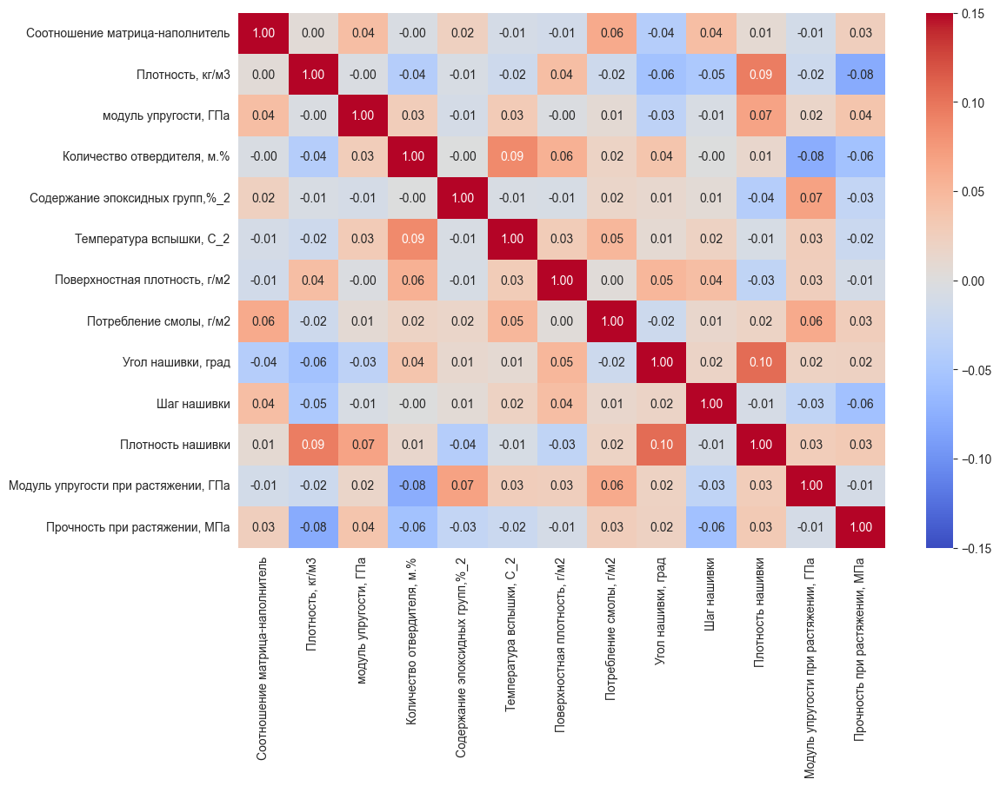

Оценить нормализацию по гистограммам и "ящикам с усами", Wall time: 1.99 s  (Yes=1 / No= any_key)? p

	Формируем тренировочную и тестовую выборки для 2 задачи
 Обучение нескольких моделей для прогноза ['Модуль упругости при растяжении, ГПа', 'Прочность при растяжении, МПа']
размерность X_train (700, 11)
размерность y_train (700, 2)
размерность X_test (300, 11)
размерность y_test (300, 2)


In [9]:
if __name__ == '__main__':

    df = data_parser(PATH_TPL)                      # получение и объединение данных
    EDA_search_dialog(df)                           # разведочный анализ данных
    df = data_cleaner_estimator.transform(df)       # исключение выбросов
    EDA_search_dialog(df)                           # повторный анализ данных после исключения выбросов
    
    min_max_scaler = MinMaxScaler()                 # prerocessing
    df = normaliser(df, min_max_scaler)

    print(f'\n\tФормируем тренировочную и тестовую выборки для 2 задачи'
          f'\n Обучение нескольких моделей для прогноза {TARGET_VARS}')
    X_train, X_test, y_train, y_test = train_test_split(df.drop(TARGET_VARS, axis=1), 
                                                        df[TARGET_VARS],
                                                        test_size=0.3, random_state=RANDOM_STATE)
    print('размерность X_train', X_train.shape) 
    print('размерность y_train', y_train.shape)
    print('размерность X_test', X_test.shape)
    print('размерность y_test', y_test.shape)

- как видим, повторы по отдельным переменным есть только в первых 23 строках взятых из X_bp.xlsx и
- в первых 40 строках из X_nup.xlsx, 
- при этом нет дубликатов по всем параметрам. Удаления из датасета не требуют.

In [10]:
models_default_list = {
    'DummyRegressor': DummyRegressor(strategy='mean'),
    'LinearRegression': LinearRegression(),
    'Ridge': Ridge(),
    'Lasso': Lasso(),
    'SVR': SVR(),
    'KNeighborsRegressor': KNeighborsRegressor(),
    'DecisionTreeRegressor': DecisionTreeRegressor(random_state=RANDOM_STATE),
    'RandomForestRegressor': RandomForestRegressor(random_state=RANDOM_STATE)
}
scoring_dict = {'R2': 'r2',
                'RMSE': 'neg_root_mean_squared_error',
                'MAE': 'neg_mean_absolute_error',
                'MAPE': 'neg_mean_absolute_percentage_error',
                'MAX_E': 'max_error',
                'mean poisson deviance': 'neg_mean_poisson_deviance',
                #'MGDev': 'neg_mean_gamma_deviance',
                'mean squared log error': 'neg_mean_squared_log_error',
                'ExpVar': 'explained_variance'
               }

In [11]:
%%time
# Сравнение моделей с параметрами по умолчанию     Wall time: 6.64 s
for i, var in enumerate(TARGET_VARS):
    print(TARGET_VARS[i])
    cv_run(models_default_list, X_train, y_train[TARGET_VARS[i]])

Модуль упругости при растяжении, ГПа


,R2,RMSE,MAE,MAPE,MAX_E,mean poisson deviance,mean squared log error,ExpVar
DummyRegressor,-0.02,-0.17,-0.13,-3227615175771.72,-0.42,-0.06,-0.01,-0.00
LinearRegression,-0.02,-0.17,-0.13,-3100265701691.69,-0.43,-0.06,-0.01,0.00
Ridge,-0.02,-0.17,-0.13,-3107958973760.74,-0.43,-0.06,-0.01,0.00
Lasso,-0.02,-0.17,-0.13,-3227615175771.72,-0.42,-0.06,-0.01,-0.00
SVR,-0.24,-0.18,-0.15,-3115842797169.89,-0.48,-0.07,-0.02,-0.21
KNeighborsRegressor,-0.23,-0.18,-0.15,-3254002935789.42,-0.47,-0.07,-0.02,-0.21
DecisionTreeRegressor,-1.08,-0.24,-0.19,-2240781714598.39,-0.62,-0.13,-0.03,-1.03
RandomForestRegressor,-0.08,-0.17,-0.14,-3516256118189.00,-0.45,-0.06,-0.01,-0.05


Прочность при растяжении, МПа


,R2,RMSE,MAE,MAPE,MAX_E,mean poisson deviance,mean squared log error,ExpVar
DummyRegressor,-0.02,-0.18,-0.14,-0.45,-0.46,-0.06,-0.01,-0.00
LinearRegression,-0.01,-0.17,-0.14,-0.45,-0.46,-0.06,-0.01,0.01
Ridge,-0.01,-0.17,-0.14,-0.45,-0.46,-0.06,-0.01,0.01
Lasso,-0.02,-0.18,-0.14,-0.45,-0.46,-0.06,-0.01,-0.00
SVR,-0.13,-0.18,-0.15,-0.48,-0.51,-0.07,-0.02,-0.10
KNeighborsRegressor,-0.20,-0.19,-0.15,-0.48,-0.50,-0.07,-0.02,-0.18
DecisionTreeRegressor,-1.11,-0.25,-0.20,-0.60,-0.64,-0.14,-0.03,-1.06
RandomForestRegressor,-0.04,-0.18,-0.14,-0.46,-0.47,-0.07,-0.01,-0.02


CPU times: total: 5.92 s
Wall time: 6.62 s


In [12]:
# Словари для хранения гиперпараметров 1-й и 2-й подзадач
models_dict_list = [{}, {}]
key_estimator = 'MAE'


def params_selection(regressor, x, y, params, key_estimator='MAE'):
    
    search_0, model_0 = grid_search(regressor(), params, x, y[TARGET_VARS[0]], key_estimator)
    search_1, model_1 = grid_search(regressor(), params, x, y[TARGET_VARS[1]], key_estimator)
    models_dict_list[0][str(model_0)] = model_0
    models_dict_list[1][str(model_1)] = model_1
    search_1[f'{key_estimator}.'] = search_1.pop(key_estimator)
    search_1['rank.'] = search_1.pop('rank')
    search_3_rank = pd.concat((pd.DataFrame(search_0[search_0['rank'] < 4].reset_index(drop=True)),
                               pd.DataFrame(search_1[search_1['rank.'] < 4].reset_index(drop=True))), axis=1)
    return search_3_rank.style.format(precision=2).highlight_max(subset=[key_estimator, f'{key_estimator}.'], axis=0)



In [13]:
%%time
#            Wall time: 11 s
params_selection(Ridge, X_train, y_train, [{
                                            'solver': ['auto', 'svd', 'cholesky', 'lsqr', 'sparse_cg'],
                                            'alpha': range(10, 1510, 10)
                                        },
                                         {
                                            'solver': ['lbfgs'],
                                            'alpha': range(10, 1510, 10),
                                            'positive': [True]
                                        }], key_estimator)

Fitting 10 folds for each of 900 candidates, totalling 9000 fits
Fitting 10 folds for each of 900 candidates, totalling 9000 fits
CPU times: total: 7.75 s
Wall time: 15.1 s


,"Модуль упругости при растяжении, ГПа",MAE,rank,"Прочность при растяжении, МПа",MAE.,rank.
0,"{'alpha': 10, 'solver': 'auto'}",-0.13,3,"{'alpha': 20, 'solver': 'auto'}",-0.14,2.00
1,"{'alpha': 10, 'solver': 'svd'}",-0.13,3,"{'alpha': 20, 'solver': 'svd'}",-0.14,2.00
2,"{'alpha': 10, 'solver': 'cholesky'}",-0.13,3,"{'alpha': 20, 'solver': 'cholesky'}",-0.14,2.00
3,"{'alpha': 10, 'positive': True, 'solver': 'lbfgs'}",-0.13,1,"{'alpha': 20, 'solver': 'sparse_cg'}",-0.14,1.00
4,"{'alpha': 20, 'positive': True, 'solver': 'lbfgs'}",-0.13,2,nan,nan,nan


In [14]:
%%time
#                Wall time: 404 ms
params_selection(Lasso, X_train, y_train, {
                                            'alpha': [0.00001, 0.00005, 0.0001, 0.0005, 0.001, 0.005, 
                                                        0.01, 0.05, 0.095, 0.1, 0.150, 0.2, 0.5, 1]
                                        }, key_estimator)

Fitting 10 folds for each of 14 candidates, totalling 140 fits
Fitting 10 folds for each of 14 candidates, totalling 140 fits
CPU times: total: 328 ms
Wall time: 394 ms


,"Модуль упругости при растяжении, ГПа",MAE,rank,"Прочность при растяжении, МПа",MAE.,rank.
0,{'alpha': 0.0001},-0.13,3,{'alpha': 0.0001},-0.14,3
1,{'alpha': 0.0005},-0.13,1,{'alpha': 0.0005},-0.14,2
2,{'alpha': 0.001},-0.13,2,{'alpha': 0.001},-0.14,1


In [15]:
%%time
#          Wall time: 1.33 s
params_selection(SVR, X_train, y_train, [{
                                            'kernel': ['linear'],
                                            'C': [0.001, 0.005, 0.01, 0.015, 0.02, 0.03]
                                        },
                                        {
                                            'kernel': ['poly'],
                                            'C': [0.001, 0.01, 0.02]
                                        },
                                        {
                                            'kernel': ['rbf'],
                                            'C': [0.01, 0.02, 0.03, 0.04]
                                        },
                                        {
                                            'kernel': ['sigmoid'],
                                            'C': [0.01, 0.02, 0.03, 0.04, 0.5]
                                        }], key_estimator)

Fitting 10 folds for each of 18 candidates, totalling 180 fits
Fitting 10 folds for each of 18 candidates, totalling 180 fits
CPU times: total: 438 ms
Wall time: 1.32 s


,"Модуль упругости при растяжении, ГПа",MAE,rank,"Прочность при растяжении, МПа",MAE.,rank.
0,"{'C': 0.02, 'kernel': 'linear'}",-0.13,2,"{'C': 0.01, 'kernel': 'linear'}",-0.14,2
1,"{'C': 0.03, 'kernel': 'linear'}",-0.13,1,"{'C': 0.02, 'kernel': 'linear'}",-0.14,3
2,"{'C': 0.02, 'kernel': 'rbf'}",-0.13,3,"{'C': 0.001, 'kernel': 'poly'}",-0.14,1


In [16]:
%%time
#      Wall time: 594 ms
params_selection(KNeighborsRegressor, X_train, y_train, {
                                            'n_neighbors': range(3, 31, 2)
                                        }, key_estimator)

Fitting 10 folds for each of 14 candidates, totalling 140 fits
Fitting 10 folds for each of 14 candidates, totalling 140 fits
CPU times: total: 438 ms
Wall time: 572 ms


,"Модуль упругости при растяжении, ГПа",MAE,rank,"Прочность при растяжении, МПа",MAE.,rank.
0,{'n_neighbors': 25},-0.14,2,{'n_neighbors': 19},-0.14,3
1,{'n_neighbors': 27},-0.14,3,{'n_neighbors': 23},-0.14,2
2,{'n_neighbors': 29},-0.14,1,{'n_neighbors': 29},-0.14,1


In [17]:
%%time
#    Wall time: 4.06 s
params_selection(DecisionTreeRegressor, X_train, y_train, {
                                            'random_state': [RANDOM_STATE],
                                            'criterion': ['squared_error', 'friedman_mse', 
                                                          'absolute_error', 'poisson'],
                                            'splitter': ['best', 'random'],
                                            'max_depth': [1, 2, 3, 5],
                                            'max_features': range(1, 12, 2)
                                        }, key_estimator)

Fitting 10 folds for each of 192 candidates, totalling 1920 fits
Fitting 10 folds for each of 192 candidates, totalling 1920 fits
CPU times: total: 2.45 s
Wall time: 4 s


,"Модуль упругости при растяжении, ГПа",MAE,rank,"Прочность при растяжении, МПа",MAE.,rank.
0,"{'criterion': 'squared_error', 'max_depth': 1, 'max_features': 7, 'random_state': 42, 'splitter': 'random'}",-0.13,3.00,"{'criterion': 'squared_error', 'max_depth': 1, 'max_features': 7, 'random_state': 42, 'splitter': 'random'}",-0.14,3
1,"{'criterion': 'friedman_mse', 'max_depth': 1, 'max_features': 7, 'random_state': 42, 'splitter': 'random'}",-0.13,3.00,"{'criterion': 'squared_error', 'max_depth': 1, 'max_features': 9, 'random_state': 42, 'splitter': 'random'}",-0.14,3
2,"{'criterion': 'poisson', 'max_depth': 1, 'max_features': 7, 'random_state': 42, 'splitter': 'random'}",-0.13,3.00,"{'criterion': 'squared_error', 'max_depth': 2, 'max_features': 9, 'random_state': 42, 'splitter': 'random'}",-0.14,1
3,"{'criterion': 'poisson', 'max_depth': 2, 'max_features': 5, 'random_state': 42, 'splitter': 'best'}",-0.13,1.00,"{'criterion': 'friedman_mse', 'max_depth': 1, 'max_features': 7, 'random_state': 42, 'splitter': 'random'}",-0.14,3
4,"{'criterion': 'poisson', 'max_depth': 2, 'max_features': 9, 'random_state': 42, 'splitter': 'best'}",-0.13,2.00,"{'criterion': 'friedman_mse', 'max_depth': 1, 'max_features': 9, 'random_state': 42, 'splitter': 'random'}",-0.14,3
5,nan,nan,nan,"{'criterion': 'friedman_mse', 'max_depth': 2, 'max_features': 9, 'random_state': 42, 'splitter': 'random'}",-0.14,1
6,nan,nan,nan,"{'criterion': 'poisson', 'max_depth': 1, 'max_features': 7, 'random_state': 42, 'splitter': 'random'}",-0.14,3
7,nan,nan,nan,"{'criterion': 'poisson', 'max_depth': 1, 'max_features': 9, 'random_state': 42, 'splitter': 'random'}",-0.14,3


In [18]:
%%time
#            Wall time: 1min 2s
params_selection(RandomForestRegressor, X_train, y_train, {
                                            'random_state': [RANDOM_STATE],
                                            'n_estimators': [50, 100], 
                                            'criterion': ['absolute_error'],
                                            'max_depth': [2, 3, 4, 5],
                                            'max_features': [1, 2, 11],
                                            'bootstrap': [False]
                                        }, key_estimator)

Fitting 10 folds for each of 24 candidates, totalling 240 fits
Fitting 10 folds for each of 24 candidates, totalling 240 fits
CPU times: total: 1.95 s
Wall time: 1min 1s


,"Модуль упругости при растяжении, ГПа",MAE,rank,"Прочность при растяжении, МПа",MAE.,rank.
0,"{'bootstrap': False, 'criterion': 'absolute_error', 'max_depth': 4, 'max_features': 1, 'n_estimators': 50, 'random_state': 42}",-0.13,3,"{'bootstrap': False, 'criterion': 'absolute_error', 'max_depth': 2, 'max_features': 1, 'n_estimators': 50, 'random_state': 42}",-0.14,2
1,"{'bootstrap': False, 'criterion': 'absolute_error', 'max_depth': 4, 'max_features': 1, 'n_estimators': 100, 'random_state': 42}",-0.13,1,"{'bootstrap': False, 'criterion': 'absolute_error', 'max_depth': 2, 'max_features': 1, 'n_estimators': 100, 'random_state': 42}",-0.14,1
2,"{'bootstrap': False, 'criterion': 'absolute_error', 'max_depth': 5, 'max_features': 1, 'n_estimators': 50, 'random_state': 42}",-0.13,2,"{'bootstrap': False, 'criterion': 'absolute_error', 'max_depth': 3, 'max_features': 1, 'n_estimators': 50, 'random_state': 42}",-0.14,3


In [19]:
%%time
#                Wall time: 39.4 s
params_selection(GradientBoostingRegressor, X_train, y_train, {
                                            'random_state': [RANDOM_STATE],
                                            'loss': ['squared_error', 'absolute_error'], 
                                            'criterion': ['friedman_mse', 'squared_error'],
                                            'n_estimators': [50, 100, 150],
                                            'max_depth': [1, 2, 3],
                                            'max_features': [1, 2, 5, 11]    
                                        }, key_estimator)

Fitting 10 folds for each of 144 candidates, totalling 1440 fits
Fitting 10 folds for each of 144 candidates, totalling 1440 fits
CPU times: total: 4.92 s
Wall time: 38.9 s


,"Модуль упругости при растяжении, ГПа",MAE,rank,"Прочность при растяжении, МПа",MAE.,rank.
0,"{'criterion': 'friedman_mse', 'loss': 'absolute_error', 'max_depth': 3, 'max_features': 1, 'n_estimators': 50, 'random_state': 42}",-0.13,3,"{'criterion': 'friedman_mse', 'loss': 'squared_error', 'max_depth': 1, 'max_features': 2, 'n_estimators': 100, 'random_state': 42}",-0.14,3
1,"{'criterion': 'friedman_mse', 'loss': 'absolute_error', 'max_depth': 3, 'max_features': 11, 'n_estimators': 50, 'random_state': 42}",-0.13,1,"{'criterion': 'friedman_mse', 'loss': 'squared_error', 'max_depth': 2, 'max_features': 5, 'n_estimators': 50, 'random_state': 42}",-0.14,1
2,"{'criterion': 'squared_error', 'loss': 'absolute_error', 'max_depth': 3, 'max_features': 1, 'n_estimators': 50, 'random_state': 42}",-0.13,3,"{'criterion': 'squared_error', 'loss': 'squared_error', 'max_depth': 1, 'max_features': 2, 'n_estimators': 100, 'random_state': 42}",-0.14,3
3,"{'criterion': 'squared_error', 'loss': 'absolute_error', 'max_depth': 3, 'max_features': 11, 'n_estimators': 50, 'random_state': 42}",-0.13,1,"{'criterion': 'squared_error', 'loss': 'squared_error', 'max_depth': 2, 'max_features': 5, 'n_estimators': 50, 'random_state': 42}",-0.14,1


In [20]:
%%time
#            Wall time: 7.75 s
# Сравнение моделей с подобранными параметрами, поиск лучшей  
for i in range(2):
    print(f'\nСравнение моделей с подобранными параметрами, поиск лучшей для {TARGET_VARS[i]}:')
    cv_run(models_dict_list[i], X_train, y_train[TARGET_VARS[i]])


Сравнение моделей с подобранными параметрами, поиск лучшей для Модуль упругости при растяжении, ГПа:


,R2,RMSE,MAE,MAPE,MAX_E,mean poisson deviance,mean squared log error,ExpVar
"Ridge(alpha=10, positive=True, solver='lbfgs')",-0.01,-0.17,-0.13,-3194776709539.04,-0.42,-0.06,-0.01,0.01
Lasso(alpha=0.0005),-0.01,-0.17,-0.13,-3118731800033.02,-0.43,-0.06,-0.01,0.01
"SVR(C=0.03, kernel='linear')",-0.01,-0.17,-0.13,-3153135442750.89,-0.43,-0.06,-0.01,0.01
KNeighborsRegressor(n_neighbors=29),-0.04,-0.17,-0.14,-3004003008609.06,-0.43,-0.06,-0.01,-0.01
"DecisionTreeRegressor(criterion='poisson', max_depth=2, max_features=5, random_state=42)",-0.02,-0.17,-0.13,-3118947527427.89,-0.44,-0.06,-0.01,-0.00
"RandomForestRegressor(bootstrap=False, criterion='absolute_error', max_depth=4, max_features=1, random_state=42)",-0.02,-0.17,-0.13,-3293469729236.03,-0.43,-0.06,-0.01,0.00
"GradientBoostingRegressor(loss='absolute_error', max_features=11, n_estimators=50, random_state=42)",-0.04,-0.17,-0.13,-3254179829187.26,-0.45,-0.06,-0.01,-0.02



Сравнение моделей с подобранными параметрами, поиск лучшей для Прочность при растяжении, МПа:


,R2,RMSE,MAE,MAPE,MAX_E,mean poisson deviance,mean squared log error,ExpVar
"Ridge(alpha=20, solver='sparse_cg')",-0.01,-0.17,-0.14,-0.45,-0.46,-0.06,-0.01,0.01
Lasso(alpha=0.001),-0.01,-0.17,-0.14,-0.45,-0.46,-0.06,-0.01,0.01
"SVR(C=0.001, kernel='poly')",-0.01,-0.17,-0.14,-0.44,-0.46,-0.06,-0.01,0.02
KNeighborsRegressor(n_neighbors=29),-0.03,-0.18,-0.14,-0.45,-0.47,-0.06,-0.01,-0.00
"DecisionTreeRegressor(max_depth=2, max_features=9, random_state=42, splitter='random')",-0.03,-0.18,-0.14,-0.45,-0.46,-0.07,-0.01,-0.01
"RandomForestRegressor(bootstrap=False, criterion='absolute_error', max_depth=2, max_features=1, random_state=42)",-0.02,-0.18,-0.14,-0.44,-0.45,-0.06,-0.01,0.00
"GradientBoostingRegressor(max_depth=2, max_features=5, n_estimators=50, random_state=42)",0.00,-0.17,-0.14,-0.44,-0.45,-0.06,-0.01,0.03


CPU times: total: 7.8 s
Wall time: 7.8 s


In [31]:


# обучение модели, получение прогноза на актуальных X_train, y_train, X_test, y_test, TARGET_VARS
# и визуализация предсказанных значений целевых переменных
def fit_predict_and_plot(pair_of_model, X_train, y_train, X_test, y_test):
    stat = pd.DataFrame()
    y_pred = [[], []]
    for i in range(2):
        pair_of_model[i].fit(X_train, y_train[TARGET_VARS[i]])
        y_pred[i] = pair_of_model[i].predict(X_test)
        plt.figure(figsize=(15, 4))
        plt.title(f'Тестовые и прогнозные значения. Модель = {pair_of_model[i]}, целевая переменная = {TARGET_VARS[i]}')
        plt.plot(y_test[TARGET_VARS[i]].to_numpy(), label=f'Тест - {TARGET_VARS[i]}')
        plt.plot(y_pred[i], label='Прогноз')
        plt.legend(loc='best')
        plt.ylabel('н')
        plt.xlabel('Порядок')
        plt.show()
    stat = pd.DataFrame()
    for i in range(2):
        stat.loc[f'{TARGET_VARS[i]} - {pair_of_model[i]}', 'R2'] = metrics.r2_score(y_test[TARGET_VARS[i]], y_pred[i])
        stat.loc[f'{TARGET_VARS[i]} - {pair_of_model[i]}',
                 'RMSE'] = metrics.mean_squared_error(y_test[TARGET_VARS[i]], y_pred[i], squared=False) * -1
        stat.loc[f'{TARGET_VARS[i]} - {pair_of_model[i]}',
                 'MAE'] = metrics.mean_absolute_error(y_test[TARGET_VARS[i]], y_pred[i]) * -1
        stat.loc[f'{TARGET_VARS[i]} - {pair_of_model[i]}',
                 'MAPE'] = metrics.mean_absolute_percentage_error(y_test[TARGET_VARS[i]], y_pred[i]) * -1
        stat.loc[f'{TARGET_VARS[i]} - {pair_of_model[i]}',
                 'max_error'] = metrics.max_error(y_test[TARGET_VARS[i]], y_pred[i]) * -1
    stat.reset_index(inplace=True)
    best_models_estimation_list.extend(stat.values.tolist())
    display(stat.set_index('index').style.format(precision=4).highlight_max(axis=1))

    

Сравнение лучших моделей с подобранными параметрами 
для прогноза двух целевых параметров 
и визуализация предсказанных значений целевых переменных


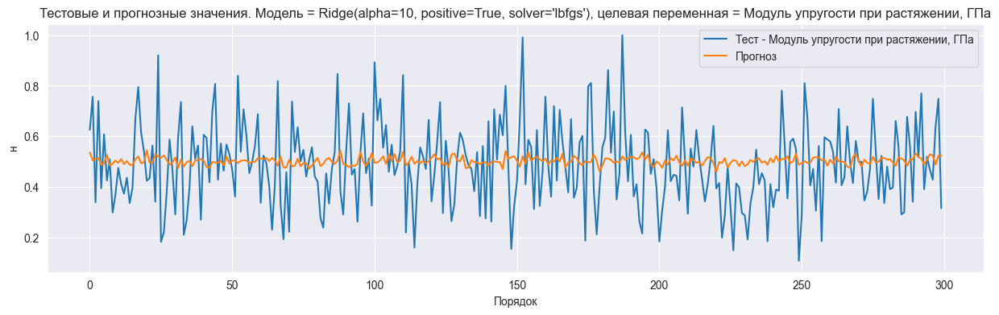

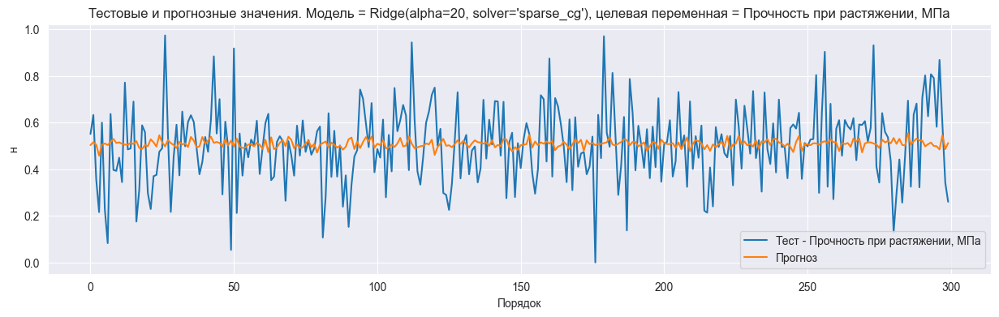

,R2,RMSE,MAE,MAPE,max_error
index,,,,,
"Модуль упругости при растяжении, ГПа - Ridge(alpha=10, positive=True, solver='lbfgs')",-0.0113,-0.1658,-0.1337,-0.3543,-0.4800
"Прочность при растяжении, МПа - Ridge(alpha=20, solver='sparse_cg')",-0.0120,-0.1662,-0.1298,-7553508868244.1699,-0.5032


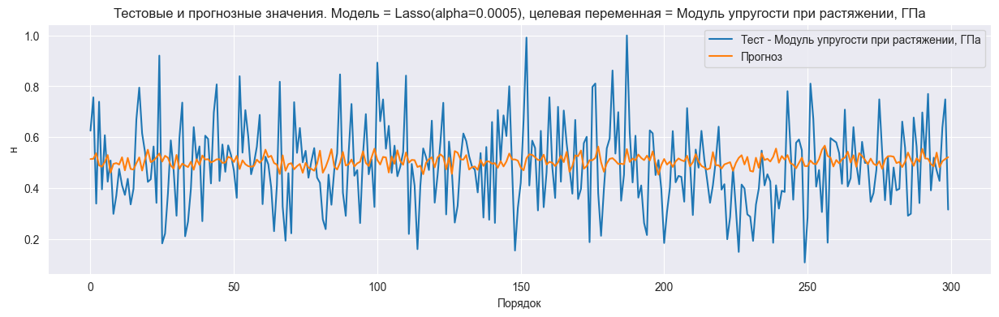

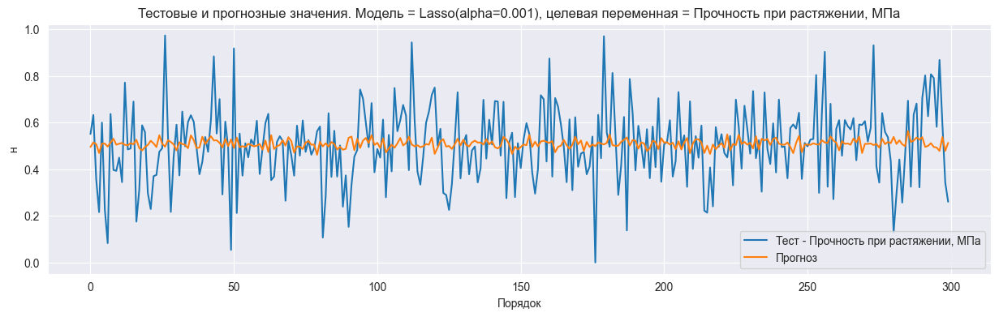

,R2,RMSE,MAE,MAPE,max_error
index,,,,,
"Модуль упругости при растяжении, ГПа - Lasso(alpha=0.0005)",-0.0234,-0.1668,-0.1349,-0.3587,-0.4749
"Прочность при растяжении, МПа - Lasso(alpha=0.001)",-0.0144,-0.1664,-0.1299,-7484779995267.6445,-0.4986


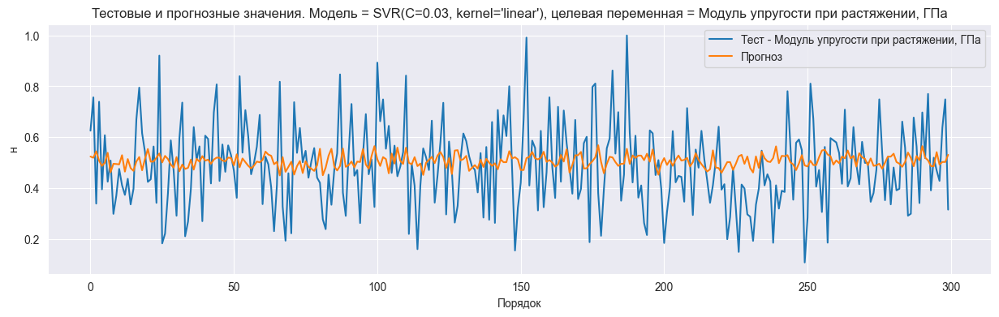

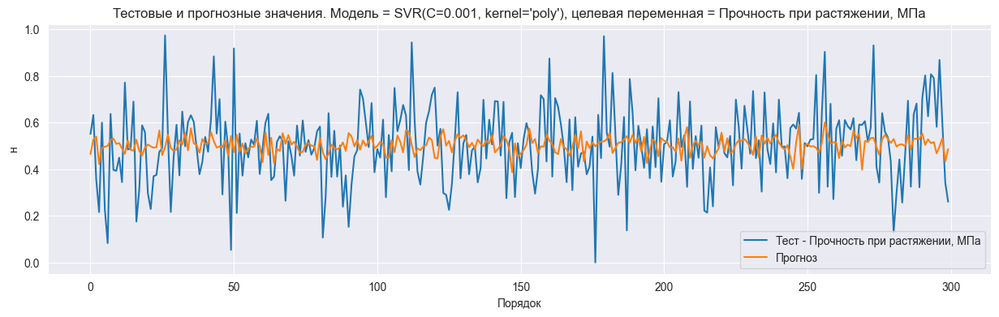

,R2,RMSE,MAE,MAPE,max_error
index,,,,,
"Модуль упругости при растяжении, ГПа - SVR(C=0.03, kernel='linear')",-0.0305,-0.1673,-0.1355,-0.3602,-0.4741
"Прочность при растяжении, МПа - SVR(C=0.001, kernel='poly')",-0.0269,-0.1674,-0.1313,-7471062696336.4082,-0.4977


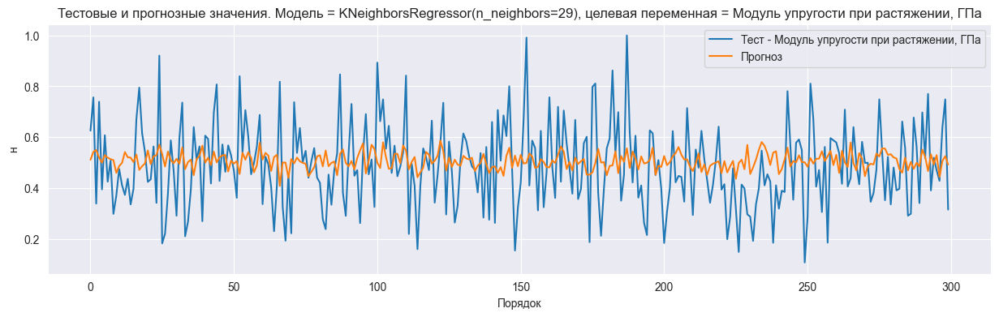

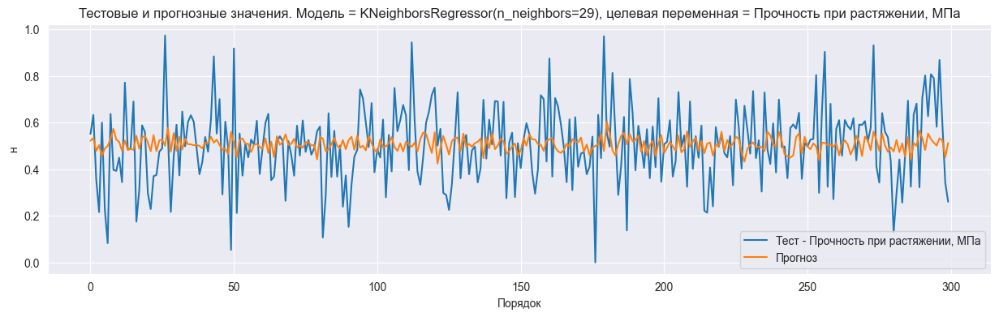

,R2,RMSE,MAE,MAPE,max_error
index,,,,,
"Модуль упругости при растяжении, ГПа - KNeighborsRegressor(n_neighbors=29)",-0.0223,-0.1667,-0.1345,-0.3569,-0.4928
"Прочность при растяжении, МПа - KNeighborsRegressor(n_neighbors=29)",-0.0131,-0.1663,-0.1311,-7495854483062.8750,-0.5054


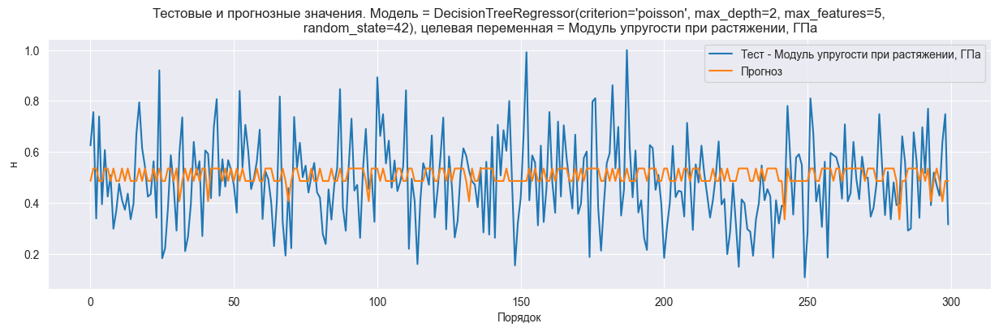

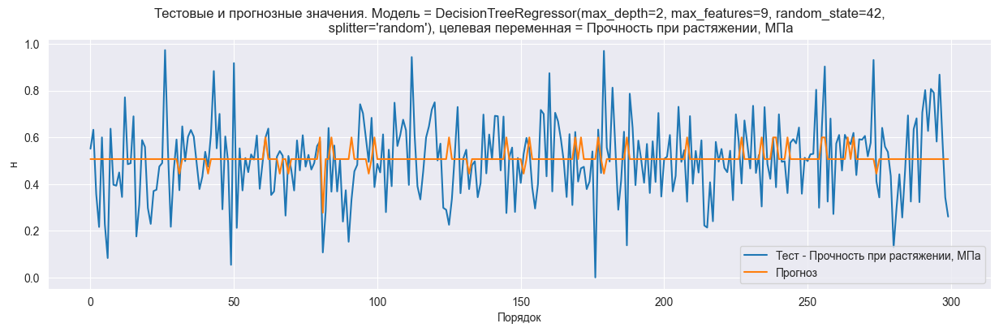

,R2,RMSE,MAE,MAPE,max_error
index,,,,,
"Модуль упругости при растяжении, ГПа - DecisionTreeRegressor(criterion='poisson', max_depth=2, max_features=5, random_state=42)",-0.0300,-0.1673,-0.1347,-0.3606,-0.5056
"Прочность при растяжении, МПа - DecisionTreeRegressor(max_depth=2, max_features=9, random_state=42, splitter='random')",-0.0326,-0.1679,-0.1302,-7604216108291.8232,-0.5254


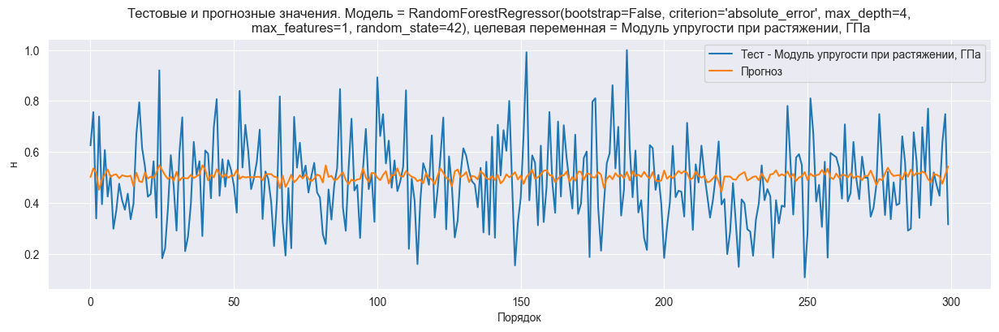

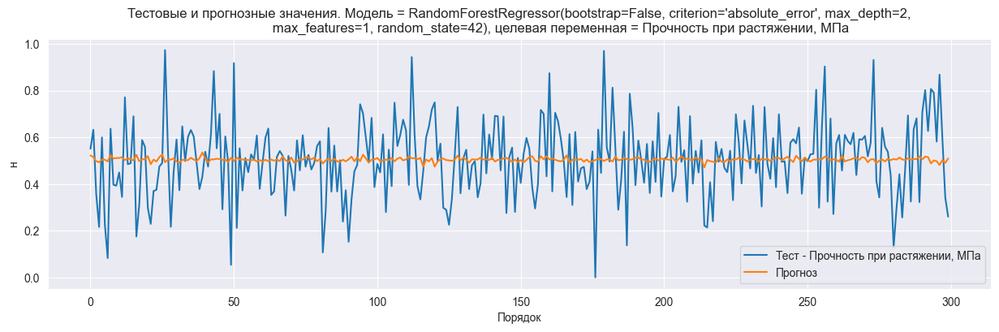

,R2,RMSE,MAE,MAPE,max_error
index,,,,,
"Модуль упругости при растяжении, ГПа - RandomForestRegressor(bootstrap=False, criterion='absolute_error', max_depth=4, max_features=1, random_state=42)",-0.0381,-0.1680,-0.1345,-0.3587,-0.4895
"Прочность при растяжении, МПа - RandomForestRegressor(bootstrap=False, criterion='absolute_error', max_depth=2, max_features=1, random_state=42)",-0.0034,-0.1655,-0.1297,-7544281506984.0215,-0.5026


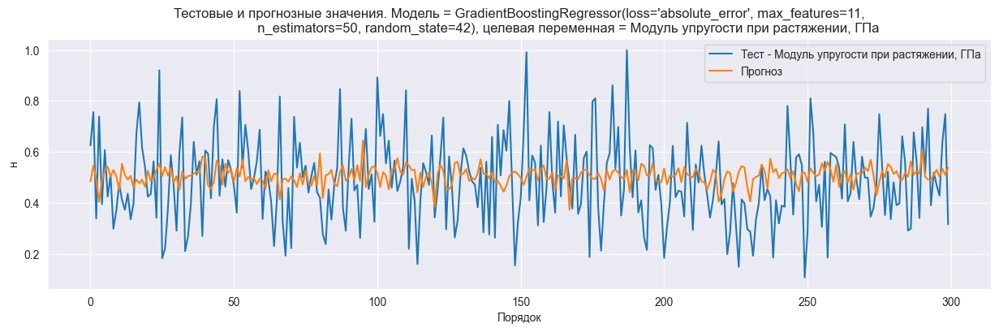

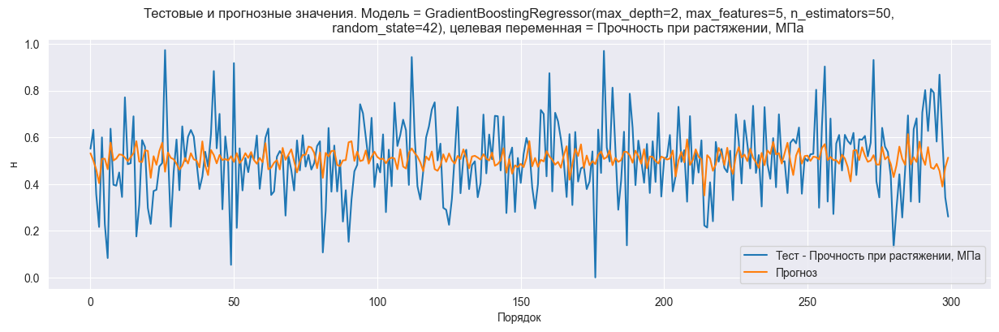

,R2,RMSE,MAE,MAPE,max_error
index,,,,,
"Модуль упругости при растяжении, ГПа - GradientBoostingRegressor(loss='absolute_error', max_features=11, n_estimators=50, random_state=42)",-0.0685,-0.1704,-0.1371,-0.3649,-0.4888
"Прочность при растяжении, МПа - GradientBoostingRegressor(max_depth=2, max_features=5, n_estimators=50, random_state=42)",-0.0182,-0.1667,-0.1316,-7282090525130.6738,-0.5207


CPU times: total: 2.73 s
Wall time: 2.74 s


In [32]:
%%time               
# Wall time: 2.96 s
# Сравнение лучших моделей с подобранными параметрами и визуализация предсказанных значений целевых переменных
print('''Сравнение лучших моделей с подобранными параметрами 
для прогноза двух целевых параметров 
и визуализация предсказанных значений целевых переменных''')
best_models_estimation_list = []
model_pair_tuple = tuple(zip(models_dict_list[0].values(), models_dict_list[1].values()))
for pair in model_pair_tuple:
    fit_predict_and_plot(pair, X_train, y_train, X_test, y_test)
best_models_df = pd.DataFrame(best_models_estimation_list,
                              columns=['best models',
                                       'R2',
                                       'RMSE',
                                       'MAE',
                                       'MAPE',
                                       'max_error']).sort_values('best models').set_index('best models')

In [33]:
display(best_models_df.iloc[0:7].style.format(precision=4).highlight_max(axis=0))
display(best_models_df.iloc[7:14].style.format(precision=4).highlight_max(axis=0))

,R2,RMSE,MAE,MAPE,max_error
best models,,,,,
"Модуль упругости при растяжении, ГПа - DecisionTreeRegressor(criterion='poisson', max_depth=2, max_features=5, random_state=42)",-0.0300,-0.1673,-0.1347,-0.3606,-0.5056
"Модуль упругости при растяжении, ГПа - GradientBoostingRegressor(loss='absolute_error', max_features=11, n_estimators=50, random_state=42)",-0.0685,-0.1704,-0.1371,-0.3649,-0.4888
"Модуль упругости при растяжении, ГПа - KNeighborsRegressor(n_neighbors=29)",-0.0223,-0.1667,-0.1345,-0.3569,-0.4928
"Модуль упругости при растяжении, ГПа - Lasso(alpha=0.0005)",-0.0234,-0.1668,-0.1349,-0.3587,-0.4749
"Модуль упругости при растяжении, ГПа - RandomForestRegressor(bootstrap=False, criterion='absolute_error', max_depth=4, max_features=1, random_state=42)",-0.0381,-0.1680,-0.1345,-0.3587,-0.4895
"Модуль упругости при растяжении, ГПа - Ridge(alpha=10, positive=True, solver='lbfgs')",-0.0113,-0.1658,-0.1337,-0.3543,-0.4800
"Модуль упругости при растяжении, ГПа - SVR(C=0.03, kernel='linear')",-0.0305,-0.1673,-0.1355,-0.3602,-0.4741


,R2,RMSE,MAE,MAPE,max_error
best models,,,,,
"Прочность при растяжении, МПа - DecisionTreeRegressor(max_depth=2, max_features=9, random_state=42, splitter='random')",-0.0326,-0.1679,-0.1302,-7604216108291.8232,-0.5254
"Прочность при растяжении, МПа - GradientBoostingRegressor(max_depth=2, max_features=5, n_estimators=50, random_state=42)",-0.0182,-0.1667,-0.1316,-7282090525130.6738,-0.5207
"Прочность при растяжении, МПа - KNeighborsRegressor(n_neighbors=29)",-0.0131,-0.1663,-0.1311,-7495854483062.8750,-0.5054
"Прочность при растяжении, МПа - Lasso(alpha=0.001)",-0.0144,-0.1664,-0.1299,-7484779995267.6445,-0.4986
"Прочность при растяжении, МПа - RandomForestRegressor(bootstrap=False, criterion='absolute_error', max_depth=2, max_features=1, random_state=42)",-0.0034,-0.1655,-0.1297,-7544281506984.0215,-0.5026
"Прочность при растяжении, МПа - Ridge(alpha=20, solver='sparse_cg')",-0.0120,-0.1662,-0.1298,-7553508868244.1699,-0.5032
"Прочность при растяжении, МПа - SVR(C=0.001, kernel='poly')",-0.0269,-0.1674,-0.1313,-7471062696336.4082,-0.4977


In [623]:
# вывод

In [ ]:
    pipe = Pipeline(steps=[
    ('cleaner', data_cleaner_estimator),
    ('scaler', MinMaxScaler()),
 #   ('spliter', spliter_estimator),
    ('classifier', LinearRegression())
]) 

In [34]:
# Сформируем тренировочную и целевую выборки для решения 3-й задачи.

X_train, X_test, y_train, y_test = train_test_split(df.drop(TARGET_FOR_NS, axis=1), 
                                                    df[TARGET_FOR_NS],
                                                    test_size=0.3, random_state=RANDOM_STATE)

In [35]:
print('размерность X_train', X_train.shape) 
print('размерность y_train', y_train.shape)
print('размерность X_test', X_test.shape)
print('размерность y_test', y_test.shape)
X_train.describe().T

размерность X_train (700, 12)
размерность y_train (700,)
размерность X_test (300, 12)
размерность y_test (300,)


,count,mean,std,min,25%,50%,75%,max
"Плотность, кг/м3",700.0,0.460015,0.179172,0.000000,0.331535,0.456148,0.577349,1.000000
"модуль упругости, ГПа",700.0,0.446995,0.198017,0.000000,0.300911,0.447128,0.578954,1.000000
"Количество отвердителя, м.%",700.0,0.504391,0.172236,0.022518,0.386047,0.504557,0.620749,1.000000
"Содержание эпоксидных групп,%_2",700.0,0.488956,0.176111,0.000000,0.370037,0.486866,0.617724,0.996408
"Температура вспышки, С_2",700.0,0.490792,0.176589,0.002124,0.370292,0.490563,0.609167,1.000000
"Поверхностная плотность, г/м2",700.0,0.372812,0.215577,0.000825,0.206374,0.358634,0.531926,0.997948
"Потребление смолы, г/м2",700.0,0.508277,0.168013,0.000000,0.393195,0.507419,0.619798,1.000000
"Угол нашивки, град",700.0,0.495714,0.500339,0.000000,0.000000,0.000000,1.000000,1.000000
Шаг нашивки,700.0,0.475095,0.179892,0.000000,0.354105,0.476915,0.593526,0.971720
Плотность нашивки,700.0,0.508781,0.166270,0.000000,0.401573,0.507366,0.615928,1.000000


In [36]:
# Функция для построения графика ошибки
def plot_loss(history):
    fig, axes = plt.subplots(1, 2, figsize=(12, 4))
    axes[0].plot(history['loss'], label='loss')
    axes[0].plot(history['val_loss'], label='val_loss')
    axes[0].set_xlabel('Эпоха')
    axes[0].set_ylabel('MAPE')
    axes[0].legend()
    axes[0].grid(True)
    axes[1].plot(history['root_mean_squared_error'], label='loss')
    axes[1].plot(history['val_root_mean_squared_error'], label='val_loss')
    axes[1].set_xlabel('Эпоха')
    axes[1].set_ylabel('RMSE')
    axes[1].legend()
    axes[1].grid(True)
    plt.show()

    
# Функция, компилирующая нейросеть с заданными параметрами
def compile_model(some_model):
    some_model.compile(
      optimizer=keras.optimizers.Adam(),
      loss=keras.losses.MeanAbsolutePercentageError(),
      metrics=[tf.keras.metrics.RootMeanSquaredError()]
    )
    return model    
    
    

In [37]:
def get_metrics(model_name, y, y_pred):
    stat = pd.DataFrame()
    stat.loc[model_name, 'R2'] = metrics.r2_score(y, y_pred)
    stat.loc[model_name, 'RMSE'] = metrics.mean_squared_error(y, y_pred, squared=False) * -1
    stat.loc[model_name, 'MAE'] = metrics.mean_absolute_error(y, y_pred) * -1
    stat.loc[model_name, 'MAPE'] = metrics.mean_absolute_percentage_error(y, y_pred) * -1
    stat.loc[model_name, 'max_error'] = metrics.max_error(y, y_pred) * -1
    return stat

In [38]:
model = Sequential()
model.add(Dense(50, input_dim=12, activation='relu'))
model.add(Dense(128, activation='relu'))
model.add(Dense(128, activation='relu'))
model.add(Dense(64, activation='relu'))
model.add(Dense(32, activation='softmax'))
model.add(Dense(1))

In [39]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 50)                650       
                                                                 
 dense_1 (Dense)             (None, 128)               6528      
                                                                 
 dense_2 (Dense)             (None, 128)               16512     
                                                                 
 dense_3 (Dense)             (None, 64)                8256      
                                                                 
 dense_4 (Dense)             (None, 32)                2080      
                                                                 
 dense_5 (Dense)             (None, 1)                 33        
                                                                 
Total params: 34,059
Trainable params: 34,059
Non-traina

In [40]:
%%time
#                                       Wall time: 9.55 s
dfmodel = compile_model(model)
history = model.fit(
    X_train,
    y_train,
    validation_split=0.2, 
    verbose=1, epochs=200)

Epoch 1/200
18/18 [==============================] - 1s 9ms/step - loss: 73.8841 - root_mean_squared_error: 0.4212 - val_loss: 44.4997 - val_root_mean_squared_error: 0.2562
Epoch 2/200
18/18 [==============================] - 0s 2ms/step - loss: 38.2990 - root_mean_squared_error: 0.1938 - val_loss: 44.3841 - val_root_mean_squared_error: 0.1848
Epoch 3/200
18/18 [==============================] - 0s 3ms/step - loss: 37.2022 - root_mean_squared_error: 0.1826 - val_loss: 42.0556 - val_root_mean_squared_error: 0.1987
Epoch 4/200
18/18 [==============================] - 0s 2ms/step - loss: 36.9696 - root_mean_squared_error: 0.1886 - val_loss: 42.1810 - val_root_mean_squared_error: 0.1973
Epoch 5/200
18/18 [==============================] - 0s 2ms/step - loss: 36.9466 - root_mean_squared_error: 0.1877 - val_loss: 42.1956 - val_root_mean_squared_error: 0.1971
Epoch 6/200
18/18 [==============================] - 0s 2ms/step - loss: 36.9784 - root_mean_squared_error: 0.1873 - val_loss: 42.2494 

18/18 [==============================] - 0s 2ms/step - loss: 32.5505 - root_mean_squared_error: 0.1814 - val_loss: 46.3184 - val_root_mean_squared_error: 0.2070
Epoch 49/200
18/18 [==============================] - 0s 2ms/step - loss: 32.0152 - root_mean_squared_error: 0.1827 - val_loss: 45.8424 - val_root_mean_squared_error: 0.1940
Epoch 50/200
18/18 [==============================] - 0s 2ms/step - loss: 31.7087 - root_mean_squared_error: 0.1823 - val_loss: 46.9841 - val_root_mean_squared_error: 0.2276
Epoch 51/200
18/18 [==============================] - 0s 2ms/step - loss: 31.9870 - root_mean_squared_error: 0.1818 - val_loss: 46.7496 - val_root_mean_squared_error: 0.2021
Epoch 52/200
18/18 [==============================] - 0s 2ms/step - loss: 31.2707 - root_mean_squared_error: 0.1819 - val_loss: 47.1306 - val_root_mean_squared_error: 0.1980
Epoch 53/200
18/18 [==============================] - 0s 2ms/step - loss: 31.3852 - root_mean_squared_error: 0.1770 - val_loss: 47.0117 - val_r

18/18 [==============================] - 0s 2ms/step - loss: 23.7261 - root_mean_squared_error: 0.1551 - val_loss: 48.2724 - val_root_mean_squared_error: 0.2064
Epoch 96/200
18/18 [==============================] - 0s 2ms/step - loss: 25.1459 - root_mean_squared_error: 0.1619 - val_loss: 49.3254 - val_root_mean_squared_error: 0.2076
Epoch 97/200
18/18 [==============================] - 0s 2ms/step - loss: 24.3106 - root_mean_squared_error: 0.1589 - val_loss: 48.6316 - val_root_mean_squared_error: 0.2104
Epoch 98/200
18/18 [==============================] - 0s 2ms/step - loss: 24.0029 - root_mean_squared_error: 0.1559 - val_loss: 48.4459 - val_root_mean_squared_error: 0.2015
Epoch 99/200
18/18 [==============================] - 0s 2ms/step - loss: 23.5916 - root_mean_squared_error: 0.1551 - val_loss: 49.2829 - val_root_mean_squared_error: 0.2021
Epoch 100/200
18/18 [==============================] - 0s 2ms/step - loss: 23.5480 - root_mean_squared_error: 0.1557 - val_loss: 48.8932 - val_

Epoch 142/200
18/18 [==============================] - 0s 2ms/step - loss: 18.7246 - root_mean_squared_error: 0.1393 - val_loss: 49.1443 - val_root_mean_squared_error: 0.2059
Epoch 143/200
18/18 [==============================] - 0s 2ms/step - loss: 18.5163 - root_mean_squared_error: 0.1369 - val_loss: 48.9491 - val_root_mean_squared_error: 0.1986
Epoch 144/200
18/18 [==============================] - 0s 2ms/step - loss: 17.6363 - root_mean_squared_error: 0.1364 - val_loss: 48.7394 - val_root_mean_squared_error: 0.1986
Epoch 145/200
18/18 [==============================] - 0s 2ms/step - loss: 17.9952 - root_mean_squared_error: 0.1335 - val_loss: 49.1865 - val_root_mean_squared_error: 0.2015
Epoch 146/200
18/18 [==============================] - 0s 2ms/step - loss: 18.0705 - root_mean_squared_error: 0.1353 - val_loss: 48.4244 - val_root_mean_squared_error: 0.1954
Epoch 147/200
18/18 [==============================] - 0s 2ms/step - loss: 17.5848 - root_mean_squared_error: 0.1342 - val_lo

Epoch 189/200
18/18 [==============================] - 0s 2ms/step - loss: 14.1790 - root_mean_squared_error: 0.1185 - val_loss: 51.4376 - val_root_mean_squared_error: 0.1983
Epoch 190/200
18/18 [==============================] - 0s 3ms/step - loss: 14.4555 - root_mean_squared_error: 0.1176 - val_loss: 51.6513 - val_root_mean_squared_error: 0.2033
Epoch 191/200
18/18 [==============================] - 0s 2ms/step - loss: 13.8214 - root_mean_squared_error: 0.1160 - val_loss: 52.2907 - val_root_mean_squared_error: 0.2029
Epoch 192/200
18/18 [==============================] - 0s 2ms/step - loss: 13.8869 - root_mean_squared_error: 0.1138 - val_loss: 50.9611 - val_root_mean_squared_error: 0.2067
Epoch 193/200
18/18 [==============================] - 0s 2ms/step - loss: 13.9870 - root_mean_squared_error: 0.1160 - val_loss: 52.5797 - val_root_mean_squared_error: 0.1994
Epoch 194/200
18/18 [==============================] - 0s 2ms/step - loss: 13.9977 - root_mean_squared_error: 0.1147 - val_lo

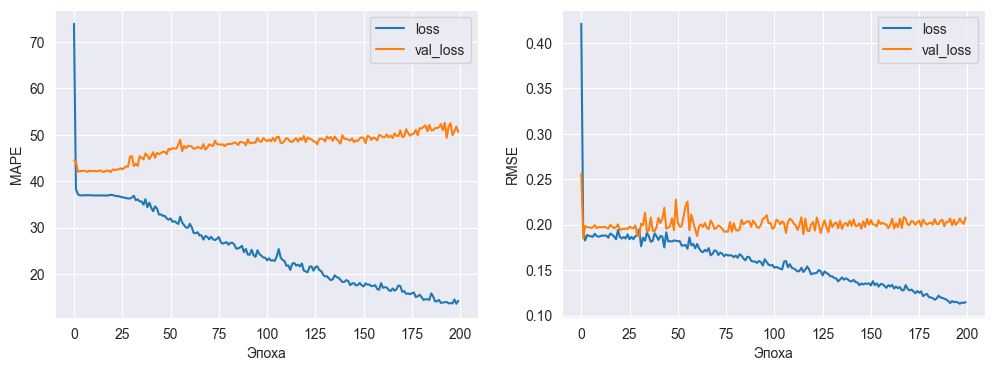

CPU times: total: 188 ms
Wall time: 193 ms


In [41]:
%%time
# Wall time: 204 ms
plot_loss(history.history)

10/10 [==============================] - 0s 890us/step


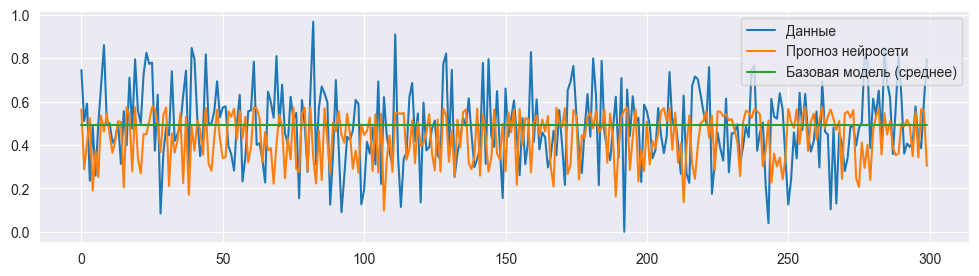

CPU times: total: 234 ms
Wall time: 243 ms


In [42]:
%%time
# Предсказание нейросети                            Wall time: 198 ms
y_pred = model.predict(X_test)
# Базовая модель
base_model = DummyRegressor(strategy='mean')
# Предсказание базовой модели
base_model.fit(X_train, y_train)
y_pred_base = base_model.predict(X_test)
# Визуализация
fig, ax = plt.subplots(figsize=(12, 3))
ax.plot(y_test.to_numpy(), label='Данные')
ax.plot(y_pred, label='Прогноз нейросети')
ax.plot(y_pred_base, label='Базовая модель (среднее)')
ax.legend()
plt.show()

In [43]:
# Сравнение предсказаний базовой модели и лучшей модели на тестовом множестве
compare = get_metrics('DummyRegressor', y_test, y_pred_base)
compare = pd.concat((compare, get_metrics('model', y_test, y_pred)),axis=0)
compare.style.format(precision=2).highlight_max(axis=0)

,R2,RMSE,MAE,MAPE,max_error
DummyRegressor,-0.00,-0.18,-0.14,-7371206150046.71,-0.49
model,-0.53,-0.22,-0.18,-8412882618286.57,-0.63


In [44]:
model_2 = Sequential()
model_2.add(BatchNormalization(input_dim=12))
model_2.add(Dense(32, activation='relu'))
model_2.add(Dense(64, activation='relu'))
model_2.add(Dropout(0.2))
model_2.add(Dense(128, activation='relu'))
model_2.add(Dense(128, activation='relu'))
model_2.add(Dropout(0.2))
model_2.add(Dense(64, activation='relu'))
model_2.add(Dense(32, activation='relu'))
model_2.add(Dropout(0.2))
model_2.add(Dense(16, activation='relu'))
model_2.add(Dense(4, activation='softmax'))
model_2.add(Dense(1))

In [45]:
model_2.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 batch_normalization (BatchN  (None, 12)               48        
 ormalization)                                                   
                                                                 
 dense_6 (Dense)             (None, 32)                416       
                                                                 
 dense_7 (Dense)             (None, 64)                2112      
                                                                 
 dropout (Dropout)           (None, 64)                0         
                                                                 
 dense_8 (Dense)             (None, 128)               8320      
                                                                 
 dense_9 (Dense)             (None, 128)               16512     
                                                      

Epoch 1/200
18/18 [==============================] - 1s 9ms/step - loss: 59.7815 - root_mean_squared_error: 0.2314 - val_loss: 51.3540 - val_root_mean_squared_error: 0.1837
Epoch 2/200
18/18 [==============================] - 0s 2ms/step - loss: 40.6072 - root_mean_squared_error: 0.2157 - val_loss: 53.0426 - val_root_mean_squared_error: 0.1857
Epoch 3/200
18/18 [==============================] - 0s 3ms/step - loss: 39.1048 - root_mean_squared_error: 0.2184 - val_loss: 54.9663 - val_root_mean_squared_error: 0.1885
Epoch 4/200
18/18 [==============================] - 0s 3ms/step - loss: 38.8839 - root_mean_squared_error: 0.1921 - val_loss: 52.7800 - val_root_mean_squared_error: 0.1857
Epoch 5/200
18/18 [==============================] - 0s 3ms/step - loss: 37.8633 - root_mean_squared_error: 0.2028 - val_loss: 52.9610 - val_root_mean_squared_error: 0.1859
Epoch 6/200
18/18 [==============================] - 0s 3ms/step - loss: 37.5236 - root_mean_squared_error: 0.1884 - val_loss: 48.9829 

18/18 [==============================] - 0s 3ms/step - loss: 24.0049 - root_mean_squared_error: 0.1558 - val_loss: 50.0669 - val_root_mean_squared_error: 0.1972
Epoch 49/200
18/18 [==============================] - 0s 3ms/step - loss: 23.8466 - root_mean_squared_error: 0.1579 - val_loss: 47.9377 - val_root_mean_squared_error: 0.1963
Epoch 50/200
18/18 [==============================] - 0s 3ms/step - loss: 23.8534 - root_mean_squared_error: 0.1549 - val_loss: 50.3932 - val_root_mean_squared_error: 0.1935
Epoch 51/200
18/18 [==============================] - 0s 3ms/step - loss: 23.8757 - root_mean_squared_error: 0.1591 - val_loss: 50.8646 - val_root_mean_squared_error: 0.1955
Epoch 52/200
18/18 [==============================] - 0s 3ms/step - loss: 23.1340 - root_mean_squared_error: 0.1606 - val_loss: 51.9079 - val_root_mean_squared_error: 0.1945
Epoch 53/200
18/18 [==============================] - 0s 3ms/step - loss: 23.0014 - root_mean_squared_error: 0.1524 - val_loss: 51.2904 - val_r

18/18 [==============================] - 0s 3ms/step - loss: 18.5766 - root_mean_squared_error: 0.1365 - val_loss: 54.9721 - val_root_mean_squared_error: 0.2056
Epoch 96/200
18/18 [==============================] - 0s 2ms/step - loss: 20.7210 - root_mean_squared_error: 0.1400 - val_loss: 54.2557 - val_root_mean_squared_error: 0.2041
Epoch 97/200
18/18 [==============================] - 0s 2ms/step - loss: 19.9844 - root_mean_squared_error: 0.1381 - val_loss: 54.8774 - val_root_mean_squared_error: 0.1988
Epoch 98/200
18/18 [==============================] - 0s 3ms/step - loss: 19.1426 - root_mean_squared_error: 0.1372 - val_loss: 55.4688 - val_root_mean_squared_error: 0.1983
Epoch 99/200
18/18 [==============================] - 0s 2ms/step - loss: 18.5688 - root_mean_squared_error: 0.1351 - val_loss: 55.7477 - val_root_mean_squared_error: 0.1963
Epoch 100/200
18/18 [==============================] - 0s 2ms/step - loss: 18.6133 - root_mean_squared_error: 0.1313 - val_loss: 55.2168 - val_

Epoch 142/200
18/18 [==============================] - 0s 3ms/step - loss: 17.1262 - root_mean_squared_error: 0.1239 - val_loss: 53.5708 - val_root_mean_squared_error: 0.1965
Epoch 143/200
18/18 [==============================] - 0s 3ms/step - loss: 15.9983 - root_mean_squared_error: 0.1219 - val_loss: 55.4876 - val_root_mean_squared_error: 0.1989
Epoch 144/200
18/18 [==============================] - 0s 2ms/step - loss: 18.1934 - root_mean_squared_error: 0.1269 - val_loss: 55.0280 - val_root_mean_squared_error: 0.2037
Epoch 145/200
18/18 [==============================] - 0s 3ms/step - loss: 16.2792 - root_mean_squared_error: 0.1150 - val_loss: 53.5920 - val_root_mean_squared_error: 0.1978
Epoch 146/200
18/18 [==============================] - 0s 3ms/step - loss: 16.9779 - root_mean_squared_error: 0.1275 - val_loss: 56.4118 - val_root_mean_squared_error: 0.1975
Epoch 147/200
18/18 [==============================] - 0s 3ms/step - loss: 16.2103 - root_mean_squared_error: 0.1193 - val_lo

Epoch 189/200
18/18 [==============================] - 0s 3ms/step - loss: 14.2019 - root_mean_squared_error: 0.1073 - val_loss: 56.5666 - val_root_mean_squared_error: 0.2066
Epoch 190/200
18/18 [==============================] - 0s 2ms/step - loss: 14.1050 - root_mean_squared_error: 0.1037 - val_loss: 55.6233 - val_root_mean_squared_error: 0.2015
Epoch 191/200
18/18 [==============================] - 0s 2ms/step - loss: 15.0237 - root_mean_squared_error: 0.1117 - val_loss: 55.4956 - val_root_mean_squared_error: 0.2011
Epoch 192/200
18/18 [==============================] - 0s 3ms/step - loss: 14.8563 - root_mean_squared_error: 0.1100 - val_loss: 55.8579 - val_root_mean_squared_error: 0.2040
Epoch 193/200
18/18 [==============================] - 0s 3ms/step - loss: 14.9606 - root_mean_squared_error: 0.1131 - val_loss: 57.2542 - val_root_mean_squared_error: 0.2047
Epoch 194/200
18/18 [==============================] - 0s 2ms/step - loss: 14.7806 - root_mean_squared_error: 0.1100 - val_lo

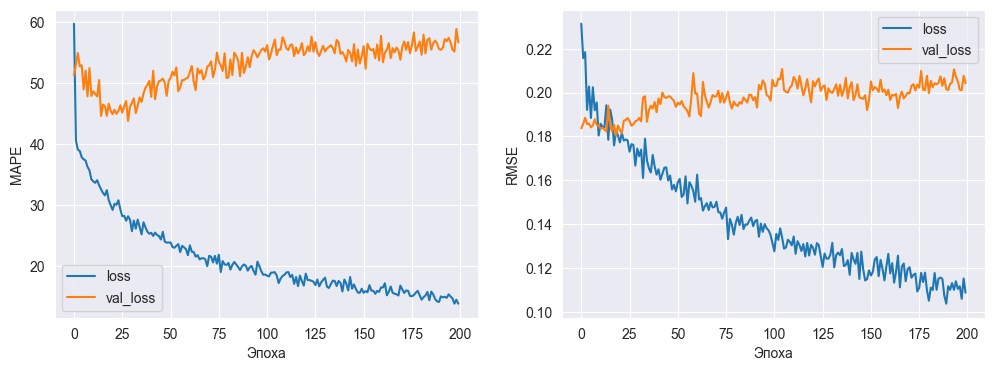

CPU times: total: 19.5 s
Wall time: 10.5 s


In [46]:
%%time
#                                            Wall time: 11.5 s
dfmodel = compile_model(model_2)
history = model_2.fit(X_train, y_train, validation_split=0.2, verbose=1, epochs=200)
plot_loss(history.history)

10/10 [==============================] - 0s 893us/step


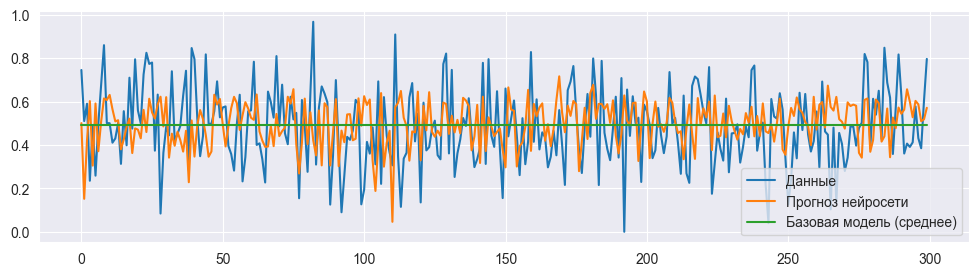

In [47]:
# Предсказание нейросети
y_pred = model_2.predict(X_test)
# Базовая модель
base_model = DummyRegressor(strategy='mean')
# Предсказание базовой модели
base_model.fit(X_train, y_train)
y_pred_base = base_model.predict(X_test)
# Визуализация
fig, ax = plt.subplots(figsize=(12, 3))
ax.plot(y_test.to_numpy(), label='Данные')
ax.plot(y_pred, label='Прогноз нейросети')
ax.plot(y_pred_base, label='Базовая модель (среднее)')
ax.legend()
plt.show()

In [48]:
# Сравнение предсказаний базовой модели и лучшей модели на тестовом множестве
compare = pd.concat((compare, get_metrics('model_2', y_test, y_pred)),axis=0)
compare.style.format(precision=2).highlight_max(axis=0)

,R2,RMSE,MAE,MAPE,max_error
DummyRegressor,-0.00,-0.18,-0.14,-7371206150046.71,-0.49
model,-0.53,-0.22,-0.18,-8412882618286.57,-0.63
model_2,-0.22,-0.20,-0.16,-9436022569260.85,-0.63


In [49]:
# Настраиваю нейросеть MLPRegressor
model_3 = MLPRegressor(
    hidden_layer_sizes = (24, 24, 24, 24, 24, 24, 24, 24),
    activation = 'relu',
    solver='adam',
    max_iter=5000,
    early_stopping = True,
    validation_fraction = 0.3,
    random_state=RANDOM_STATE, 
    verbose=True
)

In [50]:
model_2.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 batch_normalization (BatchN  (None, 12)               48        
 ormalization)                                                   
                                                                 
 dense_6 (Dense)             (None, 32)                416       
                                                                 
 dense_7 (Dense)             (None, 64)                2112      
                                                                 
 dropout (Dropout)           (None, 64)                0         
                                                                 
 dense_8 (Dense)             (None, 128)               8320      
                                                                 
 dense_9 (Dense)             (None, 128)               16512     
                                                      

Iteration 1, loss = 0.34679077
Validation score: -17.697264
Iteration 2, loss = 0.28733884
Validation score: -14.549809
Iteration 3, loss = 0.23889033
Validation score: -12.000030
Iteration 4, loss = 0.19895995
Validation score: -9.668471
Iteration 5, loss = 0.16102732
Validation score: -7.211437
Iteration 6, loss = 0.11988370
Validation score: -4.648999
Iteration 7, loss = 0.08042246
Validation score: -2.454135
Iteration 8, loss = 0.04680151
Validation score: -0.896093
Iteration 9, loss = 0.02517375
Validation score: -0.130482
Iteration 10, loss = 0.01595338
Validation score: -0.136265
Iteration 11, loss = 0.01778462
Validation score: -0.393999
Iteration 12, loss = 0.02069485
Validation score: -0.337024
Iteration 13, loss = 0.01887310
Validation score: -0.117325
Iteration 14, loss = 0.01581072
Validation score: -0.015176
Iteration 15, loss = 0.01521087
Validation score: -0.048364
Iteration 16, loss = 0.01572760
Validation score: -0.068409
Iteration 17, loss = 0.01584891
Validation sco

C:\Users\EV\anaconda3\envs\lesson1\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\EV\anaconda3\envs\lesson1\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\EV\anaconda3\envs\lesson1\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\EV\anaconda3\envs\lesson1\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\EV\anaconda3\envs\lesson1\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but MLPRegressor was fitted with feature names
  warnings.warn(
C:\Users\EV\anaconda3\envs\lesson1\lib\site-packages\sklearn

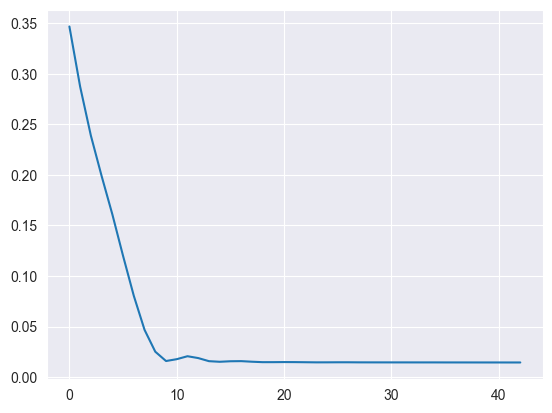

CPU times: total: 250 ms
Wall time: 238 ms


In [51]:
%%time
#                             Wall time: 247 ms
model_3.fit(X_train, y_train)
plt.plot(model_3.loss_curve_)
plt.grid(True)
plt.show()

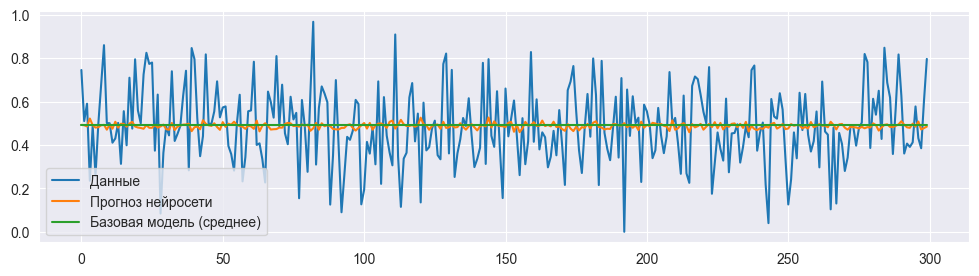

In [52]:
# Предсказание нейросети
y_pred = model_3.predict(X_test)
# Базовая модель
base_model = DummyRegressor(strategy='mean')
# Предсказание базовой модели
base_model.fit(X_train, y_train)
y_pred_base = base_model.predict(X_test)
# Визуализация
fig, ax = plt.subplots(figsize=(12, 3))
ax.plot(y_test.to_numpy(), label='Данные')
ax.plot(y_pred, label='Прогноз нейросети')
ax.plot(y_pred_base, label='Базовая модель (среднее)')
ax.legend()
plt.show()

In [53]:
# Сравнение предсказаний базовой модели и лучшей модели на тестовом множестве
compare = pd.concat((compare, get_metrics('MLPRegressor', y_test, y_pred)),axis=0)
compare.style.format(precision=2).highlight_max(axis=0)

,R2,RMSE,MAE,MAPE,max_error
DummyRegressor,-0.00,-0.18,-0.14,-7371206150046.71,-0.49
model,-0.53,-0.22,-0.18,-8412882618286.57,-0.63
model_2,-0.22,-0.20,-0.16,-9436022569260.85,-0.63
MLPRegressor,-0.01,-0.18,-0.14,-7521324657610.99,-0.50


In [54]:
# Приложение
print('''
Получить прогноз модуля упругости при растяжении и прочности при растяжении - введите "1",
Получить рекомендацию соотношения матрица-наполнитель - введите "2",
Завершить работу с приложением - введите "3", или "выход", или "exit", или пробел.
''')
for _ in range(10):
    choise = input('Введите команду (1, 2 или 3): ')
    if choise.lower() in '3 выход exit':
        break
    elif choise[0] == '2':
        nn_prediction
    elif choise[0] == '1':
        ml_prediction
    else:
        print('''Требуется ввести цифру от 1 до 3
        You need to enter a number from 1 to 3 for choise (3 for exit), try again''')



Получить прогноз модуля упругости при растяжении и прочности при растяжении - введите "1",
Получить рекомендацию соотношения матрица-наполнитель - введите "2",
Завершить работу с приложением - введите "3" или "выход" или "exit" или пробел.

Введите команду (1, 2 или 3): www
Требуется ввести цифру от 1 до 3
        You need to enter a number from 1 to 3 for choise (3 for exit), try again
Введите команду (1, 2 или 3): 


In [ ]:
def nn_prediction():
    

In [ ]:
def ml_prediction():
    